# Predicting house sale price - Modeling
## Capstone Two 

## 1. Import the necessary libraries and the data:

In [160]:
import os
import math
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# ignore warning messages to ensure clean outputs
import warnings
warnings.filterwarnings('ignore')

In [161]:
tf_train = pd.read_csv('transformed_train.csv')
tf_test = pd.read_csv('transformed_test.csv')
tf_train.head()

,LotFrontage,LotArea,OverallQual,OverallCond,YearBuilt,YearRemodAdd,MasVnrArea,ExterQual,ExterCond,BsmtQual,...,GarageType_Detchd,GarageCond_Others,GarageCond_TA,SaleType_New,SaleType_Others,SaleType_WD,SaleCondition_Others,SaleCondition_Partial,MoSold_sin,MoSold_cos
0,4.189655,9.042040,0.625,0.0,123,53,5.283204,0.5,0.0,0.666667,...,0,0,1,0,0,1,0,0,8.660254e-01,5.000000e-01
1,4.394449,9.169623,0.500,3.0,96,26,0.000000,0.0,0.0,0.666667,...,0,0,1,0,0,1,0,0,5.000000e-01,-8.660254e-01
2,4.234107,9.328212,0.625,0.0,121,52,5.093750,0.5,0.0,0.666667,...,0,0,1,0,0,1,0,0,-1.000000e+00,-1.836970e-16
3,4.110874,9.164401,0.625,0.0,35,20,0.000000,0.0,0.0,0.333333,...,1,0,1,0,0,1,1,0,8.660254e-01,5.000000e-01
4,4.442651,9.565284,0.750,0.0,120,50,5.860786,0.5,0.0,0.666667,...,0,0,1,0,0,1,0,0,-2.449294e-16,1.000000e+00


In [162]:
X_tf_train = tf_train.drop(columns="SalePrice")
y_tf_train = tf_train['SalePrice']

## 2. Models

In [163]:
# pip install optuna

In [164]:
from sklearn import __version__ as sklearn_version
from sklearn.decomposition import PCA
from sklearn.model_selection import cross_validate, GridSearchCV, learning_curve, RandomizedSearchCV
from sklearn.model_selection import cross_val_score, KFold
from sklearn.linear_model import LinearRegression
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import r2_score, mean_absolute_error, mean_squared_error, make_scorer
from sklearn.pipeline import make_pipeline
from sklearn.feature_selection import SelectKBest, f_regression
from scipy.stats import randint
import optuna
import lightgbm as lgb

from library.sb_utils import save_file

In [165]:
model_compare = {}

### 2.1 The Linear Model

#### 2.1.1 Initial Linear model

In [166]:
lr = LinearRegression().fit(X_tf_train, y_tf_train)
y_tf_tr_pred = lr.predict(X_tf_train)

Assess model performance

In [167]:
lr_ini_r2 = r2_score(y_tf_train, y_tf_tr_pred)
lr_ini_mae = mean_absolute_error(y_tf_train, y_tf_tr_pred)
lr_ini_rmse = np.sqrt(mean_squared_error(y_tf_train, y_tf_tr_pred))
print(f"R2:{lr_ini_r2}")
print(f"Mean absolute error: {lr_ini_mae}")
print(f"Root mean squared error: {lr_ini_rmse}")

R2:0.9223457769959544
Mean absolute error: 0.07044468814297856
Root mean squared error: 0.10497454480666878


In [168]:
model_compare['lr_outfit_training'] = [round(lr_ini_r2, 4), round(lr_ini_mae, 4), round(lr_ini_rmse, 4)]

I suspected the model may be overfitting given the number of features I blindly used. It's likely a judicious subset of features would generalize better. `sklearn` has a number of feature selection functions available. The one I'll use here is `SelectKBest` which selects the k best features (Ref. about SelectKBest 
[here](https://scikit-learn.org/stable/modules/generated/sklearn.feature_selection.SelectKBest.html#sklearn.feature_selection.SelectKBest)). `f_regression` is just the [score function](https://scikit-learn.org/stable/modules/generated/sklearn.feature_selection.f_regression.html#sklearn.feature_selection.f_regression) I'm using because I'm performing regression. It's important to choose an appropriate one for my machine learning task.

#### 2.1.2 Linear Regression: Default Hyperparameters & Cross-Validation

In [169]:
lr = LinearRegression().fit(X_tf_train, y_tf_train)

# Define scoring metrics
scoring = {
    'r2':'r2', 
    'mae': 'neg_mean_absolute_error', 
    'rmse': make_scorer(lambda y_true, y_pred: np.sqrt(mean_squared_error(y_true, y_pred)), greater_is_better=False)
}
# Perform cross-validation
lr_default_cv_results = cross_validate(lr, X_tf_train, y_tf_train, cv=5, scoring=scoring)
lr_default_r2_scores = lr_default_cv_results['test_r2']
lr_default_mae_scores = -lr_default_cv_results['test_mae']
lr_default_rmse_scores = -lr_default_cv_results['test_rmse']

print(f"R² Scores: {lr_default_r2_scores}")
print(f"Mean R²: {np.mean(lr_default_r2_scores):.4f}")
print(f"MAE Scores: {lr_default_mae_scores}")
print(f"Mean MAE: {np.mean(lr_default_mae_scores):.4f}")
print(f"RMSE Scores: {lr_default_rmse_scores}")
print(f"Mean RMSE: {np.mean(lr_default_rmse_scores):.4f}")

R² Scores: [0.90402632 0.88535631 0.87260892 0.91188059 0.81608188]
Mean R²: 0.8780
MAE Scores: [0.08029934 0.08486135 0.08582648 0.08577071 0.0884397 ]
Mean MAE: 0.0850
RMSE Scores: [0.114507   0.13427169 0.13607023 0.11249526 0.1517145 ]
Mean RMSE: 0.1298


In [170]:
model_compare['lr_cv_default'] = [round(np.mean(lr_default_r2_scores), 4), round(np.mean(lr_default_mae_scores), 4), round(np.mean(lr_default_rmse_scores), 4)]

#### 2.1.3 Hyperparameter search using GridSearchCV

In [171]:
# Define pipeline
pipe = make_pipeline(
    SelectKBest(f_regression),
    LinearRegression()
)

In [172]:
# Define grid parameters
k = [k+1 for k in range(len(X_tf_train.columns))]
grid_params = {'selectkbest__k':k}

# Define scoring metrics
scoring = {
    'r2':'r2', 
    'mae': 'neg_mean_absolute_error', 
    'rmse': make_scorer(lambda y_true, y_pred: np.sqrt(mean_squared_error(y_true, y_pred)), greater_is_better=False)
}

# Perform Grid Search with Cross-Validation
lr_grid_cv = GridSearchCV(pipe, param_grid=grid_params, cv=5, n_jobs=-1, scoring=scoring, refit='r2')
lr_grid_cv.fit(X_tf_train, y_tf_train)

GridSearchCV(cv=5,
             estimator=Pipeline(steps=[('selectkbest',
                                        SelectKBest(score_func=<function f_regression at 0x000001C9755A8220>)),
                                       ('linearregression',
                                        LinearRegression())]),
             n_jobs=-1,
             param_grid={'selectkbest__k': [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11,
                                            12, 13, 14, 15, 16, 17, 18, 19, 20,
                                            21, 22, 23, 24, 25, 26, 27, 28, 29,
                                            30, ...]},
             refit='r2',
             scoring={'mae': 'neg_mean_absolute_error', 'r2': 'r2',
                      'rmse': make_scorer(<lambda>, greater_is_better=False, response_method='predict')})

In [173]:
# Extract results
cv_k = [k for k in lr_grid_cv.cv_results_['param_selectkbest__k']]
lr_grid_r2_scores = lr_grid_cv.cv_results_['mean_test_r2']
lr_grid_r2_std = lr_grid_cv.cv_results_['std_test_r2']
lr_grid_mae_scores = -lr_grid_cv.cv_results_['mean_test_mae']
lr_grid_mae_std = lr_grid_cv.cv_results_['std_test_mae']
lr_grid_rmse_scores = -lr_grid_cv.cv_results_['mean_test_rmse']
lr_grid_rmse_std = lr_grid_cv.cv_results_['std_test_rmse']

Text(0.5, 1.0, 'Pipeline mean CV r-squared (error bars +/- 1sd)')

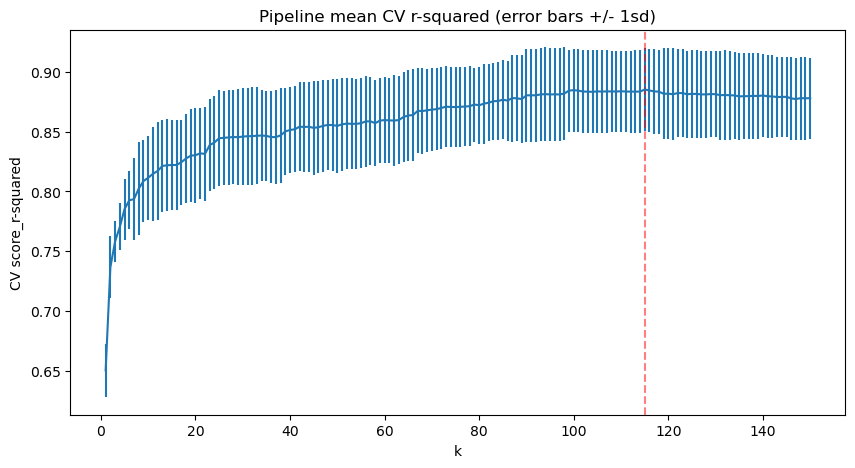

In [174]:
# Assign the value of k from the above dict of 'best_params_' and assign it to 'best_k'
lr_grid_best_k = lr_grid_cv.best_params_['selectkbest__k']
plt.subplots(figsize=(10, 5))
plt.errorbar(cv_k, lr_grid_r2_scores, yerr=lr_grid_r2_std)
plt.axvline(x=lr_grid_best_k, c='r', ls='--', alpha=.5)
plt.xlabel('k')
plt.ylabel('CV score_r-squared')
plt.title('Pipeline mean CV r-squared (error bars +/- 1sd)')

Text(0.5, 1.0, 'Pipeline mean CV MAE (error bars +/- 1sd)')

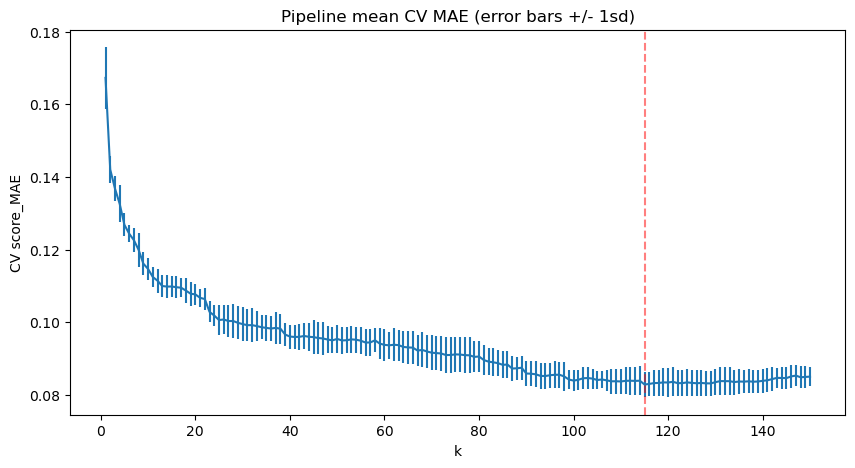

In [175]:
# Assign the value of k from the above dict of 'best_params_' and assign it to 'best_k'
plt.subplots(figsize=(10, 5))
plt.errorbar(cv_k, lr_grid_mae_scores, yerr=lr_grid_mae_std)
plt.axvline(x=lr_grid_best_k, c='r', ls='--', alpha=.5)
plt.xlabel('k')
plt.ylabel('CV score_MAE')
plt.title('Pipeline mean CV MAE (error bars +/- 1sd)')

Text(0.5, 1.0, 'Pipeline mean CV RMSE (error bars +/- 1sd)')

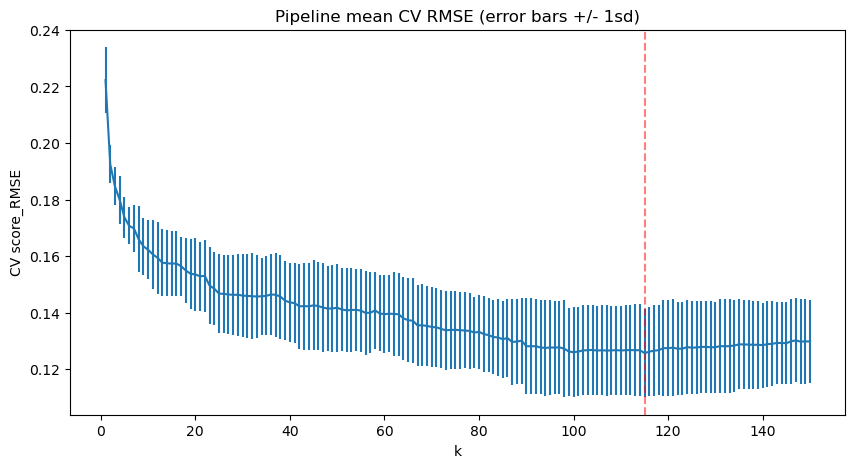

In [176]:
# Assign the value of k from the above dict of 'best_params_' and assign it to 'best_k'
plt.subplots(figsize=(10, 5))
plt.errorbar(cv_k, lr_grid_rmse_scores, yerr=lr_grid_rmse_std)
plt.axvline(x=lr_grid_best_k, c='r', ls='--', alpha=.5)
plt.xlabel('k')
plt.ylabel('CV score_RMSE')
plt.title('Pipeline mean CV RMSE (error bars +/- 1sd)')

In the r-squared plot against k, the CV score (r-squared) increases sharply for k<10k<10, followed by a more gradual rise until it plateaus around k≈80 with the mean r-squared of 0.8852. The red dashed line marks the highest mean R-squared value, but given the large error bars in the plateau region, the differences are not statistically significant. Consistently, the two loss-of-function metrics, MAE and RMSE, exhibit an inverse but similar trend to R-squared. Both MAE and RMSE decrease steeply for small k values and continue to decline at a slower rate before reaching a stable minimum, reinforcing the observed pattern in r-squared.

In [177]:
print(f'Best CV test score:{lr_grid_cv.best_score_:.4f}')

Best CV test score:0.8852


In [178]:
lr_grid_cv.best_params_

{'selectkbest__k': 115}

In [179]:
# Get the index of the best parameter set
lr_grid_best_index = lr_grid_cv.best_index_
print(lr_grid_best_index)

# Extract best R², MAE, and RMSE scores
lr_grid_best_r2 = lr_grid_cv.cv_results_['mean_test_r2'][lr_grid_best_index]
lr_grid_best_mae = -lr_grid_cv.cv_results_['mean_test_mae'][lr_grid_best_index]
lr_grid_best_rmse = -lr_grid_cv.cv_results_['mean_test_rmse'][lr_grid_best_index]

print(f'Best R² score:{lr_grid_best_r2:.4f}')
print(f'Best MAE score:{lr_grid_best_mae:.4f}')
print(f'Best RMSE score:{lr_grid_best_rmse:.4f}')

114
Best R² score:0.8852
Best MAE score:0.0829
Best RMSE score:0.1257


In [180]:
model_compare['lr_grid_bestk'] = [round(lr_grid_best_r2, 4), round(lr_grid_best_mae, 4), round(lr_grid_best_rmse, 4)]

Rank the selected features based on their model coefficients which reflect how much useful each feature is.

In [181]:
# Get a logical mask of the features selected.
selected = lr_grid_cv.best_estimator_.named_steps.selectkbest.get_support()

#get the matching feature names from the column names of the dataframe,
#and display the results as a pandas Series with `coefs` as the values and `features` as the index,
#sorting the values in descending order
coefs = lr_grid_cv.best_estimator_.named_steps.linearregression.coef_
features = X_tf_train.columns[selected]
pd.Series(coefs, index=features).sort_values(ascending=False).head(10)

OverallQual             0.393150
GrLivArea               0.276128
GarageCars              0.189571
Neighborhood_StoneBr    0.162514
Neighborhood_NridgHt    0.141937
SaleType_New            0.125386
Neighborhood_Crawfor    0.122885
Neighborhood_NoRidge    0.113129
1stFlrSF                0.094320
Neighborhood_Somerst    0.092927
dtype: float64

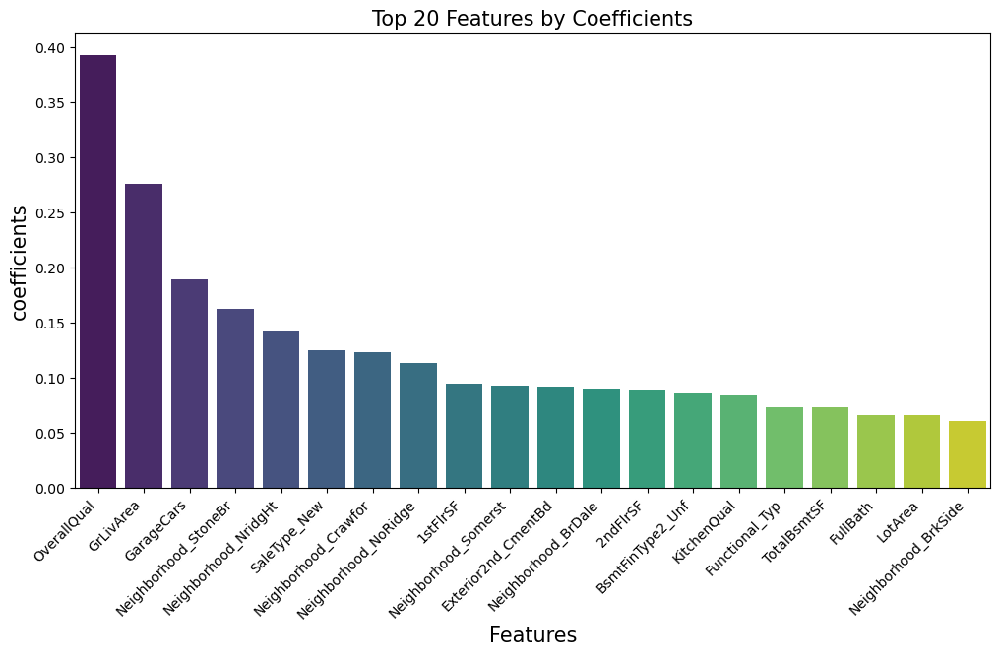

In [182]:
top_20_features = pd.Series(coefs, index=features).sort_values(ascending=False).head(20)
plt.figure(figsize=(12, 6))
sns.barplot(x=top_20_features.index, y=top_20_features.values, palette='viridis')
plt.xticks(rotation=45, ha='right')
plt.xlabel('Features',fontsize=15)
plt.ylabel('coefficients',fontsize=15)
plt.title('Top 20 Features by Coefficients',fontsize=15)
plt.show()

These results suggest that OverallQual is the most influential positive feature in predicting housing prices. Additionally, three capacity-related features—GrLivArea, GarageCars, and 1stFlrSF—rank among the top 10, aligning with expectations that larger living spaces and garage capacity contribute significantly to home value. Furthermore, five neighborhood-related features are also in the top 10, reinforcing the well-established impact of location on housing prices. Lastly, SaleType_New, which represents newly constructed and sold homes, ranks within the top 10, which is intuitively reasonable given that new homes tend to have higher market value.

### 2.2 Random Forest Model

#### 2.2.1 Random Forest: Default Hyperparameters & Cross-Validation

In [183]:
# Define RandomForestRegressor
rf = RandomForestRegressor(random_state=47)

# Define scoring
scoring = {
    'r2':'r2', 
    'mae': 'neg_mean_absolute_error', 
    'rmse': make_scorer(lambda y_true, y_pred: np.sqrt(mean_squared_error(y_true, y_pred)), greater_is_better=False)
}

# Call 'cross_validate' to estimate the model performance
# Pass it the random forest regressor object, 'X_tf_train' and 'y_tf_train', 
# and get it to use 5-fold cross-validation
rf_default_cv_results = cross_validate(rf, X_tf_train, y_tf_train, cv=5, scoring=scoring, return_train_score=True)

In [184]:
print(rf_default_cv_results.keys())

dict_keys(['fit_time', 'score_time', 'test_r2', 'train_r2', 'test_mae', 'train_mae', 'test_rmse', 'train_rmse'])


In [185]:
rf_default_cv_r2 = rf_default_cv_results['test_r2']
rf_default_cv_mae = -rf_default_cv_results['test_mae']
rf_default_cv_rmse = -rf_default_cv_results['test_rmse']

print(f"R² Scores: {rf_default_cv_r2}")
print(f"Mean R²: {np.mean(rf_default_cv_r2):.4f}")
print(f"MAE Scores: {rf_default_cv_mae}")
print(f"Mean MAE: {np.mean(rf_default_cv_mae):.4f}")
print(f"RMSE Scores: {rf_default_cv_rmse}")
print(f"Mean RMSE: {np.mean(rf_default_cv_rmse):.4f}")

R² Scores: [0.86043462 0.86287023 0.86076368 0.88957064 0.84132646]
Mean R²: 0.8630
MAE Scores: [0.09452107 0.09590423 0.09188766 0.08995896 0.09532782]
Mean MAE: 0.0935
RMSE Scores: [0.13808446 0.14685044 0.14225576 0.12593333 0.1409182 ]
Mean RMSE: 0.1388


In [186]:
model_compare['rf_cv_default'] = [round(np.mean(rf_default_cv_r2), 4), round(np.mean(rf_default_cv_mae), 4), round(np.mean(rf_default_cv_rmse), 4)]

#### 2.2.2 Random Forest: Initial hyperparameter search using GridSearchCV

In [187]:
# Generates 20 numbers logarithmically spaced between 10**1 (10) and 10**3 (1000)
n_est = [int(n) for n in np.logspace(start=1, stop=3, num=20)]
grid_params = {'n_estimators': n_est}

# Define scoring metrics
scoring = {
    'r2':'r2', 
    'mae': 'neg_mean_absolute_error', 
    'rmse': make_scorer(lambda y_true, y_pred: np.sqrt(mean_squared_error(y_true, y_pred)), greater_is_better=False)
}
# Call `GridSearchCV` with the random forest, passing in the above `grid_params`
#dict for parameters to evaluate, 5-fold cross-validation, and all available CPU cores
rf_grid_nest = GridSearchCV(rf, param_grid=grid_params, cv=5, n_jobs=-1, scoring=scoring, refit='r2')

In [188]:
#Now call the `GridSearchCV`'s `fit()` method with `X_tf_train` and `y_tf_train` as arguments
#to actually start the grid search.
rf_grid_nest.fit(X_tf_train, y_tf_train)

GridSearchCV(cv=5, estimator=RandomForestRegressor(random_state=47), n_jobs=-1,
             param_grid={'n_estimators': [10, 12, 16, 20, 26, 33, 42, 54, 69,
                                          88, 112, 143, 183, 233, 297, 379, 483,
                                          615, 784, 1000]},
             refit='r2',
             scoring={'mae': 'neg_mean_absolute_error', 'r2': 'r2',
                      'rmse': make_scorer(<lambda>, greater_is_better=False, response_method='predict')})

In [189]:
rf_grid_nest.best_params_

{'n_estimators': 1000}

In [190]:
rf_best_nest = cross_validate(rf_grid_nest.best_estimator_, X_tf_train, y_tf_train, cv=5, scoring=scoring, return_train_score=True)
rf_bestnest_r2 = rf_best_nest['test_r2']
rf_bestnest_mae = -rf_best_nest['test_mae']
rf_bestnest_rmse = -rf_best_nest['test_rmse']

print(f"R² Scores: {rf_bestnest_r2}")
print(f"Mean R²: {np.mean(rf_bestnest_r2):.4f}")
print(f"MAE Scores: {rf_bestnest_mae}")
print(f"Mean MAE: {np.mean(rf_bestnest_mae):.4f}")
print(f"RMSE Scores: {rf_bestnest_rmse}")
print(f"Mean RMSE: {np.mean(rf_bestnest_rmse):.4f}")

R² Scores: [0.86335    0.86468325 0.86367315 0.8883735  0.84222026]
Mean R²: 0.8645
MAE Scores: [0.09298976 0.09528062 0.09120091 0.08939801 0.09419425]
Mean MAE: 0.0926
RMSE Scores: [0.13663463 0.14587644 0.14076163 0.1266141  0.14052075]
Mean RMSE: 0.1381


In [191]:
model_compare['rf_grid_best_nest'] = [round(np.mean(rf_bestnest_r2), 4), round(np.mean(rf_bestnest_mae), 4), round(np.mean(rf_bestnest_rmse), 4)]

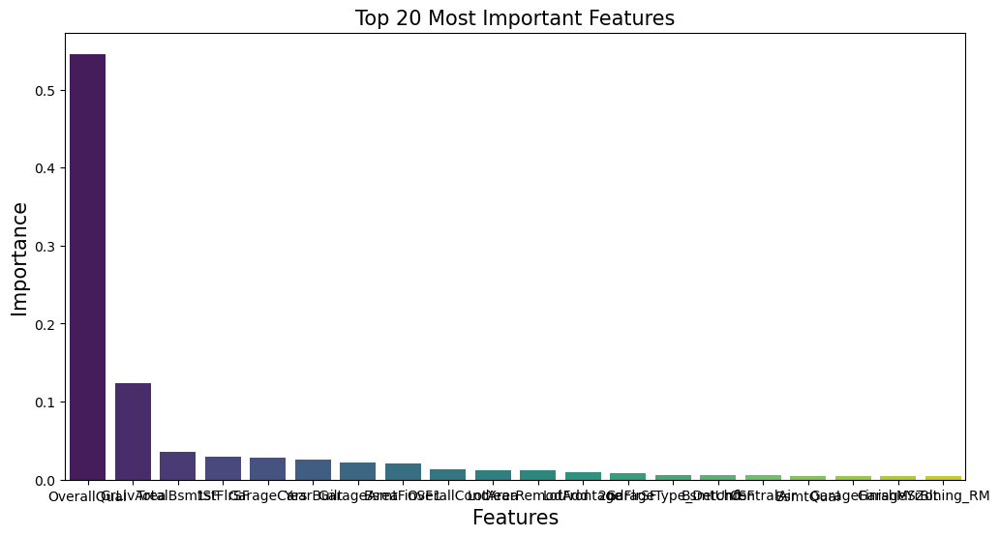

In [192]:
#Plot a barplot of the random forest's feature importances
plt.subplots(figsize=(12, 6))
imps = rf_grid_nest.best_estimator_.feature_importances_
rf_feat_imps = pd.Series(imps, index=X_tf_train.columns).sort_values(ascending=False).head(20)
sns.barplot(x=rf_feat_imps.index, y=rf_feat_imps.values, palette='viridis')
plt.xlabel('Features', fontsize=15)
plt.ylabel('Importance',fontsize=15)
plt.title('Top 20 Most Important Features',fontsize=15)
plt.show()

In [193]:
pd.Series(imps, index=X_tf_train.columns).sort_values(ascending=False).head(10)

OverallQual    0.545857
GrLivArea      0.123554
TotalBsmtSF    0.035852
1stFlrSF       0.029599
GarageCars     0.027692
YearBuilt      0.025200
GarageArea     0.021456
BsmtFinSF1     0.020387
OverallCond    0.013595
LotArea        0.012472
dtype: float64

By comparing the top 10 features from the linear regression model (coefficients) and the random forest model (feature importances), we can derive the following insights: 
1. OverallQual is the most important feature in both models, confirming its strong influence on housing prices.
2. Linear regression emphasizes categorical features (e.g., neighborhoods, sale type), while random forest prioritizes numerical structural attributes (e.g., TotalBsmtSF, YearBuilt, LotArea).
3. GrLivArea and GarageCars are important in both models but ranked differently, indicating differences in how linear and non-linear models interpret their impact.
4. Random forest captures complex interactions and non-linear relationships better, while linear regression highlights direct linear effects.

#### 2.2.3 Random Forest: Comprehensive hyperparameter search using RandomizedSearchCV

In [194]:
# Generates distionary containing the range of each hyperparameter for searching
params_dist = {
    'n_estimators': randint(50, 1000), # More trees can improve performance but also increase computation time
    'max_depth': [None, 10, 20, 30, 50], # Maximum depth of each tree, None means nodes are expanded until all leaves are pure or contain min_samples_split samples
    'min_samples_split': randint(2, 20), # Minimum number of samples required to split an internal node, Higher values prevent overfitting
    'min_samples_leaf': randint(1, 10), # Minimum number of samples required at a leaf node, Larger values smooth the model and reduce overfitting
    'max_features': ['auto', 'sqrt', 'log2', None], # Number of features to consider for splitting
    'bootstrap': [True, False], # Whether bootstrap samples are used when building trees
    }

# Define scoring metrics
scoring = {
    'r2':'r2', 
    'mae': 'neg_mean_absolute_error', 
    'rmse': make_scorer(lambda y_true, y_pred: np.sqrt(mean_squared_error(y_true, y_pred)), greater_is_better=False)
}
# Call `GridSearchCV` with the random forest, passing in the above `grid_params`
#dict for parameters to evaluate, 5-fold cross-validation, and all available CPU cores
rf_rand_search = RandomizedSearchCV(rf, param_distributions=params_dist, n_iter=20, cv=5, n_jobs=-1, scoring=scoring, refit='r2', verbose=2, random_state=42)
rf_rand_search.fit(X_tf_train, y_tf_train)

Fitting 5 folds for each of 20 candidates, totalling 100 fits


RandomizedSearchCV(cv=5, estimator=RandomForestRegressor(random_state=47),
                   n_iter=20, n_jobs=-1,
                   param_distributions={'bootstrap': [True, False],
                                        'max_depth': [None, 10, 20, 30, 50],
                                        'max_features': ['auto', 'sqrt', 'log2',
                                                         None],
                                        'min_samples_leaf': <scipy.stats._distn_infrastructure.rv_discrete_frozen object at 0x000001C91BDED4C0>,
                                        'min_samples_split': <scipy.stats._distn_infrastructure.rv_discrete_frozen object at 0x000001C91BE00980>,
                                        'n_estimators': <scipy.stats._distn_infrastructure.rv_discrete_frozen object at 0x000001C91B1AEC90>},
                   random_state=42, refit='r2',
                   scoring={'mae': 'neg_mean_absolute_error', 'r2': 'r2',
                            'rmse': make_scorer(<lambda>, greater_is_better=False, response_method='predict')},
                   verbose=2)

In [195]:
# Best estimator (model with best hyperparameters)
rf_rand_best = rf_rand_search.best_estimator_

# Get the cross_validation results
rf_rand_cv_results = rf_rand_search.cv_results_

# Extract the best R2, MAE, and RMSE
rf_rand_best_r2 = rf_rand_search.best_score_
rf_rand_best_index = rf_rand_search.best_index_

rf_rand_best_mae = -rf_rand_cv_results['mean_test_mae'][rf_rand_best_index]
rf_rand_best_rmse = -rf_rand_cv_results['mean_test_rmse'][rf_rand_best_index]

# Print results
print("Best Hyperparameters:", rf_rand_search.best_params_)
print('Best R2 Score:{:.4f}', format(rf_rand_best_r2))
print('Best MAE: {:.4f}', format(rf_rand_best_mae))
print('Best RMSE: {:.4f}', format(rf_rand_best_rmse))

model_compare['rf_rand_best'] = [round(rf_rand_best_r2,4), round(rf_rand_best_mae,4), round(rf_rand_best_rmse,4)]



Best Hyperparameters: {'bootstrap': True, 'max_depth': 10, 'max_features': None, 'min_samples_leaf': 3, 'min_samples_split': 13, 'n_estimators': 616}
Best R2 Score:{:.4f} 0.8577040340377721
Best MAE: {:.4f} 0.09500481484226078
Best RMSE: {:.4f} 0.1413917029546391


#### 2.2.4 Random Forest: Comprehensive hyperparameter search using Bayesian Optimization

In Bayesian optimization using Optuna, return multiple evaluation metrics (r2, mae, and rmse) while optimizing the model based solely on r2.

In [196]:
# Define scoring metrics
scoring = {
    'r2':'r2', 
    'mae': 'neg_mean_absolute_error', 
    'rmse': make_scorer(lambda y_true, y_pred: np.sqrt(mean_squared_error(y_true, y_pred)), greater_is_better=False)
}

def objective1(trial):

    # Suggest values for hyperparameters
    n_estimators = trial.suggest_int('n_estimators', 50, 1000) # More trees can improve performance but also increase computation time
    max_depth = trial.suggest_categorical('max_depth', [None, 10, 20, 30, 50]) # Maximum depth of each tree, None means nodes are expanded until all leaves are pure or contain min_samples_split samples
    min_samples_split = trial.suggest_int('min_samples_split', 2, 20) # Minimum number of samples required to split an internal node, Higher values prevent overfitting
    min_samples_leaf = trial.suggest_int('min_samples_leaf', 1, 10) # Minimum number of samples required at a leaf node, Larger values smooth the model and reduce overfitting
    max_features = trial.suggest_categorical('max_features', ['sqrt', 'log2', None]) # Number of features to consider for splitting
    bootstrap = trial.suggest_categorical('bootstrap', [True, False]) # Whether bootstrap samples are used when building trees

    # Define model
    rf = RandomForestRegressor(
        n_estimators=n_estimators, 
        max_depth=max_depth, 
        min_samples_split=min_samples_split,
        min_samples_leaf=min_samples_leaf,
        max_features=max_features,
        bootstrap=bootstrap, 
        random_state=47
        )
              
    # perform cross-validation
    scores = cross_validate(rf, X_tf_train, y_tf_train, cv=5, scoring=scoring, return_train_score=True)

    # Store metrics
    trial.set_user_attr('r2', scores['test_r2'].mean())
    trial.set_user_attr('mae', -scores['test_mae'].mean()) # Convert back to positive since scikit-learn returns negatives
    trial.set_user_attr('rmse', -scores['test_rmse'].mean()) # Convert back to positive
    

    return scores['test_r2'].mean() # Optimize only based on R2

# Run the optimization
study = optuna.create_study(direction='maximize') # Maximize R2
study.optimize(objective1, n_trials=20)

# Retrieve the best parameters and store the three metrics into model_compare dict
best_trial = study.best_trial
print('Best parameters:', best_trial.params)
print('Best R² Score:', best_trial.value)
print('Corresponding MAE:', best_trial.user_attrs["mae"])
print('Corresponding RMSE:', best_trial.user_attrs["rmse"])

model_compare['rf_Bay_best'] = [round(best_trial.user_attrs["r2"], 4), 
                                  round(best_trial.user_attrs['mae'], 4),
                                  round(best_trial.user_attrs['rmse'], 4)
                                  ]


[I 2025-03-14 12:16:30,012] A new study created in memory with name: no-name-689fd3d7-4eae-464c-b2e6-d51bda30a133
[I 2025-03-14 12:18:03,083] Trial 0 finished with value: 0.748325274912055 and parameters: {'n_estimators': 959, 'max_depth': 10, 'min_samples_split': 11, 'min_samples_leaf': 1, 'max_features': None, 'bootstrap': False}. Best is trial 0 with value: 0.748325274912055.
[I 2025-03-14 12:18:40,280] Trial 1 finished with value: 0.8547436160693878 and parameters: {'n_estimators': 636, 'max_depth': 10, 'min_samples_split': 19, 'min_samples_leaf': 1, 'max_features': None, 'bootstrap': True}. Best is trial 1 with value: 0.8547436160693878.
[I 2025-03-14 12:19:08,208] Trial 2 finished with value: 0.8540266039581343 and parameters: {'n_estimators': 503, 'max_depth': 30, 'min_samples_split': 16, 'min_samples_leaf': 4, 'max_features': None, 'bootstrap': True}. Best is trial 1 with value: 0.8547436160693878.
[I 2025-03-14 12:19:12,532] Trial 3 finished with value: 0.8305722390046105 and 

Best parameters: {'n_estimators': 718, 'max_depth': 30, 'min_samples_split': 2, 'min_samples_leaf': 1, 'max_features': None, 'bootstrap': True}
Best R² Score: 0.864364168829659
Corresponding MAE: 0.09250981326401833
Corresponding RMSE: 0.1381432742417517


#### 2.2.5 Random Forest with unscaled training dataset: Comprehensive hyperparameter search using Bayesian Optimization

For Random Forest alone, feature scaling is unnecessary and typically does not improve performance. However, I plan to run a new Random Forest model using Bayesian optimization with unscaled data, except for the month feature, as the sin-cos transformation may help the model recognize seasonal cycles.

In [197]:
# Load datasets 
df_train = pd.read_csv('df_train_EDA.csv')
df_test = pd.read_csv('df_test_EDA.csv')

# Identify numeric features
numeric_features = df_train.select_dtypes(include=['int64', 'float64']).columns.tolist()
categorical_features = df_train.select_dtypes(include=['object', 'category']).columns.tolist()

print(f'Total numeric features in training dataset: {len(numeric_features)}')
print(f'Total categorical features in training dataset: {len(categorical_features)}')
print(f'Total features in training dataset: {len(df_train.columns.tolist())}')


Total numeric features in training dataset: 150
Total categorical features in training dataset: 0
Total features in training dataset: 150


Apply sin-cos transformation to MoSold and update DataFrames

In [198]:
def sin_cos_transform(df, col):
    return df.assign(
        **{
            f"{col}_sin": np.sin(2 * np.pi * df[col] / 12),
            f"{col}_cos": np.cos(2 * np.pi * df[col] / 12)
            }
            ).drop(columns=[col])

# Apply to train and test data
df_train_rf = sin_cos_transform(df_train, 'MoSold')
df_test_rf = sin_cos_transform(df_test, 'MoSold')

In [199]:
X_train_rf = df_train_rf.drop(columns='SalePrice')
y_train_rf = df_train_rf['SalePrice']

In [200]:
# Define scoring metrics
scoring = {
    'r2':'r2', 
    'mae': 'neg_mean_absolute_error', 
    'rmse': make_scorer(lambda y_true, y_pred: np.sqrt(mean_squared_error(y_true, y_pred)), greater_is_better=False)
}

def objective2(trial):

    # Suggest values for hyperparameters
    n_estimators = trial.suggest_int('n_estimators', 50, 1000) # More trees can improve performance but also increase computation time
    max_depth = trial.suggest_categorical('max_depth', [None, 10, 20, 30, 50]) # Maximum depth of each tree, None means nodes are expanded until all leaves are pure or contain min_samples_split samples
    min_samples_split = trial.suggest_int('min_samples_split', 2, 20) # Minimum number of samples required to split an internal node, Higher values prevent overfitting
    min_samples_leaf = trial.suggest_int('min_samples_leaf', 1, 10) # Minimum number of samples required at a leaf node, Larger values smooth the model and reduce overfitting
    max_features = trial.suggest_categorical('max_features', ['sqrt', 'log2', None]) # Number of features to consider for splitting
    bootstrap = trial.suggest_categorical('bootstrap', [True, False]) # Whether bootstrap samples are used when building trees

    # Define model
    rf = RandomForestRegressor(
        n_estimators=n_estimators, 
        max_depth=max_depth, 
        min_samples_split=min_samples_split,
        min_samples_leaf=min_samples_leaf,
        max_features=max_features,
        bootstrap=bootstrap, 
        random_state=47
        )
              
    # perform cross-validation
    scores = cross_validate(rf, X_train_rf, y_train_rf, cv=5, scoring=scoring, return_train_score=True)

    # Store metrics
    trial.set_user_attr('r2', scores['test_r2'].mean())
    trial.set_user_attr('mae', -scores['test_mae'].mean()) # Convert back to positive since scikit-learn returns negatives
    trial.set_user_attr('rmse', -scores['test_rmse'].mean()) # Convert back to positive
    

    return scores['test_r2'].mean() # Optimize only based on R2

# Run the optimization
study2 = optuna.create_study(direction='maximize') # Maximize R2
study2.optimize(objective2, n_trials=20)

# Retrieve the best parameters and store the three metrics into model_compare dict
best_trial2 = study2.best_trial
print('Best parameters:', best_trial2.params)
print('Best R² Score:', best_trial2.value)
print('Corresponding MAE:', best_trial2.user_attrs["mae"])
print('Corresponding RMSE:', best_trial2.user_attrs["rmse"])

model_compare['rf_unscale_Bay_best'] = [round(best_trial2.user_attrs["r2"], 4), 
                                  round(best_trial2.user_attrs['mae'], 4),
                                  round(best_trial2.user_attrs['rmse'], 4)
                                  ]

print(best_trial2.user_attrs["r2"])
print(best_trial2.value)

[I 2025-03-14 12:26:55,112] A new study created in memory with name: no-name-9451a35a-7bbc-4325-b055-a55d83102b2a
[I 2025-03-14 12:27:05,133] Trial 0 finished with value: 0.8176698342059094 and parameters: {'n_estimators': 807, 'max_depth': 30, 'min_samples_split': 15, 'min_samples_leaf': 6, 'max_features': 'sqrt', 'bootstrap': True}. Best is trial 0 with value: 0.8176698342059094.
[I 2025-03-14 12:27:16,202] Trial 1 finished with value: 0.8148132312775687 and parameters: {'n_estimators': 998, 'max_depth': 20, 'min_samples_split': 15, 'min_samples_leaf': 2, 'max_features': 'log2', 'bootstrap': True}. Best is trial 0 with value: 0.8176698342059094.
[I 2025-03-14 12:27:27,288] Trial 2 finished with value: 0.8187961651078781 and parameters: {'n_estimators': 960, 'max_depth': 30, 'min_samples_split': 4, 'min_samples_leaf': 3, 'max_features': 'log2', 'bootstrap': True}. Best is trial 2 with value: 0.8187961651078781.
[I 2025-03-14 12:27:32,922] Trial 3 finished with value: 0.824286153824517

Best parameters: {'n_estimators': 600, 'max_depth': 10, 'min_samples_split': 7, 'min_samples_leaf': 2, 'max_features': 'sqrt', 'bootstrap': False}
Best R² Score: 0.85717372087376
Corresponding MAE: 17302.80336945753
Corresponding RMSE: 29685.513182524504
0.85717372087376
0.85717372087376


In [201]:
model_compare

{'lr_outfit_training': [0.9223, 0.0704, 0.105],
 'lr_cv_default': [0.878, 0.085, 0.1298],
 'lr_grid_bestk': [0.8852, 0.0829, 0.1257],
 'rf_cv_default': [0.863, 0.0935, 0.1388],
 'rf_grid_best_nest': [0.8645, 0.0926, 0.1381],
 'rf_rand_best': [0.8577, 0.095, 0.1414],
 'rf_Bay_best': [0.8644, 0.0925, 0.1381],
 'rf_unscale_Bay_best': [0.8572, 17302.8034, 29685.5132]}

In [202]:
model_compare_df = pd.DataFrame.from_dict(model_compare, orient='index')
model_compare_df.columns = ['R²', 'MAE', 'RMSE']
model_compare_df = model_compare_df.reset_index()
model_compare_df = model_compare_df.rename(columns={'index': 'Model'})
model_compare_df

,Model,R²,MAE,RMSE
0,lr_outfit_training,0.9223,0.0704,0.1050
1,lr_cv_default,0.8780,0.0850,0.1298
2,lr_grid_bestk,0.8852,0.0829,0.1257
3,rf_cv_default,0.8630,0.0935,0.1388
4,rf_grid_best_nest,0.8645,0.0926,0.1381
5,rf_rand_best,0.8577,0.0950,0.1414
6,rf_Bay_best,0.8644,0.0925,0.1381
7,rf_unscale_Bay_best,0.8572,17302.8034,29685.5132


In [203]:
model_compare_df.sort_values(by='R²', ascending=False)

,Model,R²,MAE,RMSE
0,lr_outfit_training,0.9223,0.0704,0.1050
2,lr_grid_bestk,0.8852,0.0829,0.1257
1,lr_cv_default,0.8780,0.0850,0.1298
4,rf_grid_best_nest,0.8645,0.0926,0.1381
6,rf_Bay_best,0.8644,0.0925,0.1381
3,rf_cv_default,0.8630,0.0935,0.1388
5,rf_rand_best,0.8577,0.0950,0.1414
7,rf_unscale_Bay_best,0.8572,17302.8034,29685.5132


This dataframe compares the performance of different models based on R² (coefficient of determination), MAE (Mean Absolute Error), and RMSE (Root Mean Squared Error).
Summary:
1. Linear regression models outperform random forest models in this case.
2. rf_Bay_best is the best random forest model, but still behind lr_grid_bestk.
3. Further fine-tuning may improve Random Forest performance.

### 2.3 LightGBM (Light Gradient Boosting Model)

[LightGBM](https://lightgbm.readthedocs.io/en/latest/) is a gradient boosting framework that uses tree-based learning algorithms. It is designed to be distributed and efficient with the following advantages:
* Faster training speed and higher efficiency.
* Lower memory usage.
* Better accuracy.
* Support of parallel and GPU learning.
* Capable of handling large-scale data.

Steps to configure Optuna for optimizing LightGBM hyperparameters with tracking of R², MAE, and RMSE metrics:
1. Define the objective function that LightGBM will optimize.
2. Use Optuna's Trial object to suggest hyperparameters.
3. Train the LightGBM model and evaluate it using cross-validation.
4. Return R² as the main optimization metric while logging MAE and RMSE.

#### 2.3.1 LightGBM: Comprehensive hyperparameter search using Bayesian Optimization

In [204]:
# Define Optina's objective function
def objective3(trial):
    # Hyperparameter search space
    params = {
        'objective': 'regression',
        'metric': 'rmse',
        'boosting_type': 'gbdt',
        "n_estimators": trial.suggest_int("n_estimators", 100, 1000),
        "learning_rate": trial.suggest_float("learning_rate", 0.01, 0.3, log=True),
        "num_leaves": trial.suggest_int("num_leaves", 10, 100),
        "max_depth": trial.suggest_int("max_depth", 3, 12),
        "min_child_samples": trial.suggest_int("min_child_samples", 5, 100),
        "subsample": trial.suggest_float("subsample", 0.5, 1.0),
        "colsample_bytree": trial.suggest_float("colsample_bytree", 0.5, 1.0),
        "reg_alpha": trial.suggest_float("reg_alpha", 1e-8, 10.0, log=True),
        "reg_lambda": trial.suggest_float("reg_lambda", 1e-8, 10.0, log=True),
    }

    # Create LightGBM regressor
    lgbm = lgb.LGBMRegressor(**params, random_state=42)

    # Perform cross-validation
    scores = cross_validate(lgbm, X_tf_train, y_tf_train, cv=5, scoring=scoring, return_train_score=True)

    # Store metrics
    trial.set_user_attr('r2', scores['test_r2'].mean())
    trial.set_user_attr('mae', -scores['test_mae'].mean()) # Convert back to positive since scikit-learn returns negatives
    trial.set_user_attr('rmse', -scores['test_rmse'].mean()) # Convert back to positive
    

    return scores['test_r2'].mean() # Optimize only based on R2

# Run Optuna optimization
study3 = optuna.create_study(direction='maximize')
study3.optimize(objective3, n_trials=50)

# Best parameters and best metrics
best_params = study3.best_params
best_r2 = study3.best_value
best_mae = study3.best_trial.user_attrs['mae']
best_rmse = study3.best_trial.user_attrs['rmse']

print("Best R²:", best_r2)
print("Best MAE:", best_mae)
print("Best RMSE:", best_rmse)
print("Best Parameters:", best_params)

[I 2025-03-14 12:30:59,401] A new study created in memory with name: no-name-6850be5f-339f-4873-84a3-a05bce916a59


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001490 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 3100
[LightGBM] [Info] Number of data points in the train set: 1070, number of used features: 114
[LightGBM] [Info] Start training from score 12.059454
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive

[I 2025-03-14 12:31:03,726] Trial 0 finished with value: 0.8850307831133268 and parameters: {'n_estimators': 964, 'learning_rate': 0.06862702936851461, 'num_leaves': 23, 'max_depth': 11, 'min_child_samples': 30, 'subsample': 0.6416103543490435, 'colsample_bytree': 0.7340866122525833, 'reg_alpha': 1.4982025510320552e-08, 'reg_lambda': 9.00674217756101e-08}. Best is trial 0 with value: 0.8850307831133268.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001149 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 3028
[LightGBM] [Info] Number of data points in the train set: 1070, number of used features: 79
[LightGBM] [Info] Start training from score 12.059454
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive 

[I 2025-03-14 12:31:05,173] Trial 1 finished with value: 0.8678229016246688 and parameters: {'n_estimators': 605, 'learning_rate': 0.011865407281291358, 'num_leaves': 31, 'max_depth': 9, 'min_child_samples': 67, 'subsample': 0.7703687498908875, 'colsample_bytree': 0.7279676857154291, 'reg_alpha': 1.7641501961882375, 'reg_lambda': 5.290044294142553}. Best is trial 0 with value: 0.8850307831133268.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-03-14 12:31:06,317] Trial 2 finished with value: 0.875202227294967 and parameters: {'n_estimators': 303, 'learning_rate': 0.19019272773342077, 'num_leaves': 20, 'max_depth': 8, 'min_child_samples': 47, 'subsample': 0.6940274544451015, 'colsample_bytree': 0.9075717117370607, 'reg_alpha': 6.805679112227674e-06, 'reg_lambda': 4.470850346318422e-07}. Best is trial 0 with value: 0.8850307831133268.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001587 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 3082
[LightGBM] [Info] Number of data points in the train set: 1070, number of used features: 105
[LightGBM] [Info] Start training from score 12.059454
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive

[I 2025-03-14 12:31:09,704] Trial 3 finished with value: 0.8884436643977892 and parameters: {'n_estimators': 948, 'learning_rate': 0.02909200086708338, 'num_leaves': 92, 'max_depth': 8, 'min_child_samples': 39, 'subsample': 0.5592722998209864, 'colsample_bytree': 0.7986461420278188, 'reg_alpha': 0.011078725283179132, 'reg_lambda': 0.00034884058840280727}. Best is trial 3 with value: 0.8884436643977892.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001220 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 3036
[LightGBM] [Info] Number of data points in the train set: 1070, number of used features: 83
[LightGBM] [Info] Start training from score 12.059454
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive 

[I 2025-03-14 12:31:12,515] Trial 4 finished with value: 0.8853308295530065 and parameters: {'n_estimators': 836, 'learning_rate': 0.02228684792407054, 'num_leaves': 93, 'max_depth': 10, 'min_child_samples': 63, 'subsample': 0.5052667600371066, 'colsample_bytree': 0.5523007004000096, 'reg_alpha': 7.029125412985043e-07, 'reg_lambda': 3.290128976442595e-06}. Best is trial 3 with value: 0.8884436643977892.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-03-14 12:31:16,392] Trial 5 finished with value: 0.8838435789200236 and parameters: {'n_estimators': 532, 'learning_rate': 0.010241568376466018, 'num_leaves': 37, 'max_depth': 12, 'min_child_samples': 16, 'subsample': 0.507970373794, 'colsample_bytree': 0.9062921858124275, 'reg_alpha': 0.2878685129956434, 'reg_lambda': 3.1474924070861815e-08}. Best is trial 3 with value: 0.8884436643977892.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001687 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 3065
[LightGBM] [Info] Number of data points in the train set: 1070, number of used features: 97
[LightGBM] [Info] Start training from score 12.059454
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive 

[I 2025-03-14 12:31:17,887] Trial 6 finished with value: 0.8893250946601998 and parameters: {'n_estimators': 711, 'learning_rate': 0.015141027097802006, 'num_leaves': 34, 'max_depth': 3, 'min_child_samples': 46, 'subsample': 0.9306511690246647, 'colsample_bytree': 0.5677738556615473, 'reg_alpha': 0.004667457236431027, 'reg_lambda': 0.0008794315853218285}. Best is trial 6 with value: 0.8893250946601998.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-03-14 12:31:19,231] Trial 7 finished with value: 0.8653895909732391 and parameters: {'n_estimators': 956, 'learning_rate': 0.03813626307857424, 'num_leaves': 83, 'max_depth': 9, 'min_child_samples': 88, 'subsample': 0.9070984822162613, 'colsample_bytree': 0.6632959244701229, 'reg_alpha': 2.8024079466703538, 'reg_lambda': 2.3348321393331142e-08}. Best is trial 6 with value: 0.8893250946601998.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-03-14 12:31:20,770] Trial 8 finished with value: 0.869808901793677 and parameters: {'n_estimators': 482, 'learning_rate': 0.013006593384105198, 'num_leaves': 98, 'max_depth': 9, 'min_child_samples': 81, 'subsample': 0.731331583794953, 'colsample_bytree': 0.8645106058171537, 'reg_alpha': 0.3928580253698674, 'reg_lambda': 1.3043717857517338e-07}. Best is trial 6 with value: 0.8893250946601998.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-03-14 12:31:23,231] Trial 9 finished with value: 0.8766594886497586 and parameters: {'n_estimators': 678, 'learning_rate': 0.07846199487597302, 'num_leaves': 47, 'max_depth': 10, 'min_child_samples': 64, 'subsample': 0.7271283946861637, 'colsample_bytree': 0.7803382377347174, 'reg_alpha': 0.00032226272906694947, 'reg_lambda': 0.8597674968909124}. Best is trial 6 with value: 0.8893250946601998.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002000 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 3172
[LightGBM] [Info] Number of data points in the train set: 1070, number of used features: 150
[LightGBM] [Info] Start training from score 12.059454
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive

[I 2025-03-14 12:31:24,546] Trial 10 finished with value: 0.8847190156519138 and parameters: {'n_estimators': 387, 'learning_rate': 0.25386172675486895, 'num_leaves': 58, 'max_depth': 3, 'min_child_samples': 10, 'subsample': 0.9970501093139594, 'colsample_bytree': 0.5082844221478214, 'reg_alpha': 0.0007070405313303866, 'reg_lambda': 0.002686257812168165}. Best is trial 6 with value: 0.8893250946601998.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-03-14 12:31:25,368] Trial 11 finished with value: 0.8689612721447857 and parameters: {'n_estimators': 120, 'learning_rate': 0.029716681025065625, 'num_leaves': 68, 'max_depth': 5, 'min_child_samples': 39, 'subsample': 0.8176219334117137, 'colsample_bytree': 0.6248827735287276, 'reg_alpha': 0.01029977668189874, 'reg_lambda': 0.0005174117705423569}. Best is trial 6 with value: 0.8893250946601998.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-03-14 12:31:28,086] Trial 12 finished with value: 0.8932332050770702 and parameters: {'n_estimators': 806, 'learning_rate': 0.022336562386582992, 'num_leaves': 11, 'max_depth': 6, 'min_child_samples': 28, 'subsample': 0.6201031165764491, 'colsample_bytree': 0.8241910821226534, 'reg_alpha': 0.011717796614745831, 'reg_lambda': 0.014713454420034269}. Best is trial 12 with value: 0.8932332050770702.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002248 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 3116
[LightGBM] [Info] Number of data points in the train set: 1070, number of used features: 122
[LightGBM] [Info] Start training from score 12.059454
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive

[I 2025-03-14 12:31:30,548] Trial 13 finished with value: 0.8918320344094008 and parameters: {'n_estimators': 732, 'learning_rate': 0.022360684871375217, 'num_leaves': 11, 'max_depth': 5, 'min_child_samples': 24, 'subsample': 0.8644421762781208, 'colsample_bytree': 0.9810413048571338, 'reg_alpha': 0.018266048906441328, 'reg_lambda': 0.06713694889996438}. Best is trial 12 with value: 0.8932332050770702.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-03-14 12:31:33,142] Trial 14 finished with value: 0.8910749350342193 and parameters: {'n_estimators': 790, 'learning_rate': 0.04503439996403498, 'num_leaves': 10, 'max_depth': 6, 'min_child_samples': 23, 'subsample': 0.8391377427052665, 'colsample_bytree': 0.9996066772810843, 'reg_alpha': 0.05424239258912804, 'reg_lambda': 0.05068226358067425}. Best is trial 12 with value: 0.8932332050770702.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002179 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 3172
[LightGBM] [Info] Number of data points in the train set: 1070, number of used features: 150
[LightGBM] [Info] Start training from score 12.059454
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001884 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 3182
[LightGBM] [Info] Number of data points in the train set: 1070, number of used features: 150
[LightGBM] [Info] Start training from score 12.061274
[Lig

[I 2025-03-14 12:31:36,056] Trial 15 finished with value: 0.8953311106755368 and parameters: {'n_estimators': 822, 'learning_rate': 0.019497563381748306, 'num_leaves': 10, 'max_depth': 6, 'min_child_samples': 7, 'subsample': 0.6236508716448053, 'colsample_bytree': 0.9783176352559544, 'reg_alpha': 2.1932976569635338e-05, 'reg_lambda': 0.032693168276365855}. Best is trial 15 with value: 0.8953311106755368.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.003527 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 3172
[LightGBM] [Info] Number of data points in the train set: 1070, number of used features: 150
[LightGBM] [Info] Start training from score 12.059454
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive

[I 2025-03-14 12:31:40,470] Trial 16 finished with value: 0.8878842924502257 and parameters: {'n_estimators': 837, 'learning_rate': 0.12616824211483615, 'num_leaves': 22, 'max_depth': 6, 'min_child_samples': 6, 'subsample': 0.6278414385823766, 'colsample_bytree': 0.8438667679879569, 'reg_alpha': 1.64557153048304e-05, 'reg_lambda': 1.62728361281283e-05}. Best is trial 15 with value: 0.8953311106755368.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-03-14 12:31:43,110] Trial 17 finished with value: 0.8886882093913835 and parameters: {'n_estimators': 607, 'learning_rate': 0.01734361888480436, 'num_leaves': 49, 'max_depth': 6, 'min_child_samples': 30, 'subsample': 0.6049687232812958, 'colsample_bytree': 0.9090142487953855, 'reg_alpha': 2.3585912909546805e-05, 'reg_lambda': 0.017033272232608403}. Best is trial 15 with value: 0.8953311106755368.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002225 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 3160
[LightGBM] [Info] Number of data points in the train set: 1070, number of used features: 144
[LightGBM] [Info] Start training from score 12.059454
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive

[I 2025-03-14 12:31:46,396] Trial 18 finished with value: 0.8911628945335119 and parameters: {'n_estimators': 878, 'learning_rate': 0.05977480833319807, 'num_leaves': 74, 'max_depth': 4, 'min_child_samples': 17, 'subsample': 0.6650281985697681, 'colsample_bytree': 0.9590220086425146, 'reg_alpha': 4.0468236873056746e-07, 'reg_lambda': 2.3010333612430455e-05}. Best is trial 15 with value: 0.8953311106755368.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002251 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 3172
[LightGBM] [Info] Number of data points in the train set: 1070, number of used features: 150
[LightGBM] [Info] Start training from score 12.059454
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive

[I 2025-03-14 12:31:50,414] Trial 19 finished with value: 0.8950414346398492 and parameters: {'n_estimators': 765, 'learning_rate': 0.02113447517456317, 'num_leaves': 16, 'max_depth': 7, 'min_child_samples': 5, 'subsample': 0.577697977969521, 'colsample_bytree': 0.8475663809489181, 'reg_alpha': 7.402176225842365e-05, 'reg_lambda': 0.4096269338040736}. Best is trial 15 with value: 0.8953311106755368.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001144 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 3172
[LightGBM] [Info] Number of data points in the train set: 1070, number of used features: 150
[LightGBM] [Info] Start training from score 12.059454
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive

[I 2025-03-14 12:31:56,040] Trial 20 finished with value: 0.8851179471220805 and parameters: {'n_estimators': 674, 'learning_rate': 0.10774260705590784, 'num_leaves': 44, 'max_depth': 7, 'min_child_samples': 5, 'subsample': 0.5703725399917202, 'colsample_bytree': 0.9407780869914885, 'reg_alpha': 1.6522417314398544e-06, 'reg_lambda': 0.5978607239966167}. Best is trial 15 with value: 0.8953311106755368.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001505 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 3162
[LightGBM] [Info] Number of data points in the train set: 1070, number of used features: 145
[LightGBM] [Info] Start training from scor

[I 2025-03-14 12:31:59,690] Trial 21 finished with value: 0.8924833429493075 and parameters: {'n_estimators': 773, 'learning_rate': 0.018209537258076582, 'num_leaves': 16, 'max_depth': 7, 'min_child_samples': 16, 'subsample': 0.5693727064600824, 'colsample_bytree': 0.8414161541642172, 'reg_alpha': 0.00012551448215976732, 'reg_lambda': 0.008551040737520079}. Best is trial 15 with value: 0.8953311106755368.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002392 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 3168
[LightGBM] [Info] Number of data points in the train set: 1070, number of used features: 148
[LightGBM] [Info] Start training from score 12.059454
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive

[I 2025-03-14 12:32:02,886] Trial 22 finished with value: 0.8953852633700812 and parameters: {'n_estimators': 863, 'learning_rate': 0.030656461654887897, 'num_leaves': 27, 'max_depth': 5, 'min_child_samples': 12, 'subsample': 0.6842902593305267, 'colsample_bytree': 0.8000753489277644, 'reg_alpha': 0.0006076823912242013, 'reg_lambda': 0.5688743099827358}. Best is trial 22 with value: 0.8953852633700812.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-03-14 12:32:06,190] Trial 23 finished with value: 0.8953090162915862 and parameters: {'n_estimators': 882, 'learning_rate': 0.033662030582717696, 'num_leaves': 27, 'max_depth': 5, 'min_child_samples': 11, 'subsample': 0.6810535545124985, 'colsample_bytree': 0.694173464484694, 'reg_alpha': 0.0016762945974993712, 'reg_lambda': 0.4028323212309689}. Best is trial 22 with value: 0.8953852633700812.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-03-14 12:32:08,779] Trial 24 finished with value: 0.8951556134593153 and parameters: {'n_estimators': 901, 'learning_rate': 0.035208762119380795, 'num_leaves': 28, 'max_depth': 4, 'min_child_samples': 12, 'subsample': 0.6865100230253994, 'colsample_bytree': 0.6700620898759994, 'reg_alpha': 0.0007248000287989013, 'reg_lambda': 2.391399284416345}. Best is trial 22 with value: 0.8953852633700812.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-03-14 12:32:11,940] Trial 25 finished with value: 0.8947025812759556 and parameters: {'n_estimators': 992, 'learning_rate': 0.04582268308775628, 'num_leaves': 38, 'max_depth': 5, 'min_child_samples': 18, 'subsample': 0.7715764828893724, 'colsample_bytree': 0.7031653391617728, 'reg_alpha': 0.002757116448248153, 'reg_lambda': 0.14266019246886663}. Best is trial 22 with value: 0.8953852633700812.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001954 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 3092
[LightGBM] [Info] Number of data points in the train set: 1070, number of used features: 110
[LightGBM] [Info] Start training from score 12.059454
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive

[I 2025-03-14 12:32:14,134] Trial 26 finished with value: 0.890892392221868 and parameters: {'n_estimators': 890, 'learning_rate': 0.02877939160069505, 'num_leaves': 26, 'max_depth': 4, 'min_child_samples': 36, 'subsample': 0.704106240904142, 'colsample_bytree': 0.6442258580906859, 'reg_alpha': 1.0281521338931199e-07, 'reg_lambda': 9.594388338630255}. Best is trial 22 with value: 0.8953852633700812.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-03-14 12:32:15,942] Trial 27 finished with value: 0.886589485383993 and parameters: {'n_estimators': 624, 'learning_rate': 0.04884999059565192, 'num_leaves': 63, 'max_depth': 5, 'min_child_samples': 56, 'subsample': 0.6605638935696538, 'colsample_bytree': 0.7615292021122091, 'reg_alpha': 0.0001061311614269251, 'reg_lambda': 0.17663943474078336}. Best is trial 22 with value: 0.8953852633700812.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-03-14 12:32:18,453] Trial 28 finished with value: 0.8935626055158213 and parameters: {'n_estimators': 892, 'learning_rate': 0.03722235220251341, 'num_leaves': 43, 'max_depth': 4, 'min_child_samples': 23, 'subsample': 0.7839101525155387, 'colsample_bytree': 0.6923683093628976, 'reg_alpha': 3.0076322619097462e-06, 'reg_lambda': 1.836978002843248}. Best is trial 22 with value: 0.8953852633700812.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-03-14 12:32:20,444] Trial 29 finished with value: 0.867999144051462 and parameters: {'n_estimators': 978, 'learning_rate': 0.07744082342508855, 'num_leaves': 23, 'max_depth': 3, 'min_child_samples': 98, 'subsample': 0.6507574457567235, 'colsample_bytree': 0.5949111016318687, 'reg_alpha': 0.0014628350347371786, 'reg_lambda': 0.0038965922211031006}. Best is trial 22 with value: 0.8953852633700812.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002030 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 3170
[LightGBM] [Info] Number of data points in the train set: 1070, number of used features: 149
[LightGBM] [Info] Start training from score 12.059454
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive

[I 2025-03-14 12:32:21,428] Trial 30 finished with value: 0.8729757918438168 and parameters: {'n_estimators': 113, 'learning_rate': 0.027050570394597705, 'num_leaves': 30, 'max_depth': 5, 'min_child_samples': 11, 'subsample': 0.7353143728073226, 'colsample_bytree': 0.737243207016993, 'reg_alpha': 3.416742790546875e-08, 'reg_lambda': 0.057006794139744923}. Best is trial 22 with value: 0.8953852633700812.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001587 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 3168
[LightGBM] [Info] Number of data points in the train set: 1070, number of used features: 148
[LightGBM] [Info] Start training from score 12.059454
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive

[I 2025-03-14 12:32:24,012] Trial 31 finished with value: 0.8961637855129532 and parameters: {'n_estimators': 894, 'learning_rate': 0.033889571739092406, 'num_leaves': 27, 'max_depth': 4, 'min_child_samples': 12, 'subsample': 0.6963631275662854, 'colsample_bytree': 0.6691398906209922, 'reg_alpha': 0.000545710240706403, 'reg_lambda': 2.5398528840313825}. Best is trial 31 with value: 0.8961637855129532.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-03-14 12:32:26,393] Trial 32 finished with value: 0.8919417499364878 and parameters: {'n_estimators': 931, 'learning_rate': 0.06155185583395298, 'num_leaves': 18, 'max_depth': 4, 'min_child_samples': 22, 'subsample': 0.6870202949337434, 'colsample_bytree': 0.7127740055784457, 'reg_alpha': 0.0002959091840501699, 'reg_lambda': 2.162008401476177}. Best is trial 31 with value: 0.8961637855129532.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-03-14 12:32:31,437] Trial 33 finished with value: 0.8938246858322116 and parameters: {'n_estimators': 844, 'learning_rate': 0.033519310442082104, 'num_leaves': 39, 'max_depth': 6, 'min_child_samples': 11, 'subsample': 0.6117837848603035, 'colsample_bytree': 0.6135692614790158, 'reg_alpha': 6.885405779552271e-05, 'reg_lambda': 8.387241709423852}. Best is trial 31 with value: 0.8961637855129532.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-03-14 12:32:35,032] Trial 34 finished with value: 0.8925428405333996 and parameters: {'n_estimators': 1000, 'learning_rate': 0.014422146815598585, 'num_leaves': 32, 'max_depth': 5, 'min_child_samples': 28, 'subsample': 0.6993381622987176, 'colsample_bytree': 0.7591601198058098, 'reg_alpha': 2.3711903702315763e-05, 'reg_lambda': 0.4474772870230714}. Best is trial 31 with value: 0.8961637855129532.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000837 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 3096
[LightGBM] [Info] Number of data points in the train set: 1070, number of used features: 112
[LightGBM] [Info] Start training from score 12.059454
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive

[I 2025-03-14 12:32:38,664] Trial 35 finished with value: 0.892346803135835 and parameters: {'n_estimators': 839, 'learning_rate': 0.025495454222920134, 'num_leaves': 51, 'max_depth': 8, 'min_child_samples': 33, 'subsample': 0.7602436286555666, 'colsample_bytree': 0.6789894748542209, 'reg_alpha': 0.04849490854791847, 'reg_lambda': 0.1572651267134228}. Best is trial 31 with value: 0.8961637855129532.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001378 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 3019
[LightGBM] [Info] Number of data points in the train set: 1070, number of used features: 75
[LightGBM] [Info] Start training from score 12.059454
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive 

[I 2025-03-14 12:32:40,117] Trial 36 finished with value: 0.8785609306175978 and parameters: {'n_estimators': 732, 'learning_rate': 0.017947761023175354, 'num_leaves': 24, 'max_depth': 3, 'min_child_samples': 74, 'subsample': 0.7974590856743785, 'colsample_bytree': 0.7992286907828827, 'reg_alpha': 0.001399484451871592, 'reg_lambda': 2.120908417176864}. Best is trial 31 with value: 0.8961637855129532.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-03-14 12:32:43,533] Trial 37 finished with value: 0.8867062222797051 and parameters: {'n_estimators': 929, 'learning_rate': 0.04101099641451168, 'num_leaves': 16, 'max_depth': 7, 'min_child_samples': 45, 'subsample': 0.5286990870460899, 'colsample_bytree': 0.8795413966071952, 'reg_alpha': 8.214715734817747e-06, 'reg_lambda': 6.724108775672307e-05}. Best is trial 31 with value: 0.8961637855129532.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-03-14 12:32:45,608] Trial 38 finished with value: 0.8850654718742653 and parameters: {'n_estimators': 539, 'learning_rate': 0.010062537135497023, 'num_leaves': 32, 'max_depth': 4, 'min_child_samples': 18, 'subsample': 0.6693056254717262, 'colsample_bytree': 0.7319490247200058, 'reg_alpha': 0.0002962555492415258, 'reg_lambda': 0.03815883633970774}. Best is trial 31 with value: 0.8961637855129532.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002116 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 3170
[LightGBM] [Info] Number of data points in the train set: 1070, number of used features: 149
[LightGBM] [Info] Start training from score 12.059454
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive

[I 2025-03-14 12:32:46,339] Trial 39 finished with value: 0.8260142539885678 and parameters: {'n_estimators': 198, 'learning_rate': 0.05205031362528979, 'num_leaves': 20, 'max_depth': 6, 'min_child_samples': 11, 'subsample': 0.5991227130508145, 'colsample_bytree': 0.6497436230823739, 'reg_alpha': 8.790250148310877, 'reg_lambda': 0.2646387772604993}. Best is trial 31 with value: 0.8961637855129532.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-03-14 12:32:48,975] Trial 40 finished with value: 0.8940405425758696 and parameters: {'n_estimators': 667, 'learning_rate': 0.03204888115607753, 'num_leaves': 28, 'max_depth': 5, 'min_child_samples': 15, 'subsample': 0.7184755344396171, 'colsample_bytree': 0.572121274651881, 'reg_alpha': 0.14893340549965295, 'reg_lambda': 0.9763487997075605}. Best is trial 31 with value: 0.8961637855129532.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-03-14 12:32:51,868] Trial 41 finished with value: 0.8957093814776401 and parameters: {'n_estimators': 906, 'learning_rate': 0.03537528662730678, 'num_leaves': 36, 'max_depth': 4, 'min_child_samples': 10, 'subsample': 0.6436584547576274, 'colsample_bytree': 0.6773157006161018, 'reg_alpha': 0.0007183246643577354, 'reg_lambda': 3.798550295637391}. Best is trial 31 with value: 0.8961637855129532.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001764 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 3172
[LightGBM] [Info] Number of data points in the train set: 1070, number of used features: 150
[LightGBM] [Info] Start training from score 12.059454
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive

[I 2025-03-14 12:32:54,042] Trial 42 finished with value: 0.8944173066010561 and parameters: {'n_estimators': 863, 'learning_rate': 0.02464907621158973, 'num_leaves': 37, 'max_depth': 3, 'min_child_samples': 7, 'subsample': 0.6380776797810379, 'colsample_bytree': 0.715790336071157, 'reg_alpha': 0.004287731311982571, 'reg_lambda': 4.708078405490382}. Best is trial 31 with value: 0.8961637855129532.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001124 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 3130
[LightGBM] [Info] Number of data points in the train set: 1070, number of used features: 129
[LightGBM] [Info] Start training from score 12.059454
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive

[I 2025-03-14 12:32:56,680] Trial 43 finished with value: 0.8951105065355754 and parameters: {'n_estimators': 956, 'learning_rate': 0.04205636422892128, 'num_leaves': 33, 'max_depth': 4, 'min_child_samples': 20, 'subsample': 0.7438908945495488, 'colsample_bytree': 0.6397579033185388, 'reg_alpha': 0.0007566715419526735, 'reg_lambda': 0.8839448218412292}. Best is trial 31 with value: 0.8961637855129532.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001956 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 3166
[LightGBM] [Info] Number of data points in the train set: 1070, number of used features: 147
[LightGBM] [Info] Start training from score 12.059454
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive

[I 2025-03-14 12:33:01,289] Trial 44 finished with value: 0.8894870631405294 and parameters: {'n_estimators': 479, 'learning_rate': 0.0199589816138033, 'num_leaves': 54, 'max_depth': 12, 'min_child_samples': 14, 'subsample': 0.5405010358919831, 'colsample_bytree': 0.6832607354137632, 'reg_alpha': 0.0001748024565281102, 'reg_lambda': 3.9476982961233342}. Best is trial 31 with value: 0.8961637855129532.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002331 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 3172
[LightGBM] [Info] Number of data points in the train set: 1070, number of used features: 150
[LightGBM] [Info] Start training from score 12.059454
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive

[I 2025-03-14 12:33:05,190] Trial 45 finished with value: 0.8959776945652796 and parameters: {'n_estimators': 812, 'learning_rate': 0.015454691084917765, 'num_leaves': 25, 'max_depth': 5, 'min_child_samples': 9, 'subsample': 0.6410294468753331, 'colsample_bytree': 0.7716558632579171, 'reg_alpha': 4.436872292557589e-05, 'reg_lambda': 0.001692449752163857}. Best is trial 31 with value: 0.8961637855129532.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002021 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 3112
[LightGBM] [Info] Number of data points in the train set: 1070, number of used features: 120
[LightGBM] [Info] Start training from score 12.059454
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive

[I 2025-03-14 12:33:08,044] Trial 46 finished with value: 0.8897492939632716 and parameters: {'n_estimators': 794, 'learning_rate': 0.012553617446589362, 'num_leaves': 13, 'max_depth': 4, 'min_child_samples': 26, 'subsample': 0.5926136789197516, 'colsample_bytree': 0.799036648719579, 'reg_alpha': 5.909426718742123e-06, 'reg_lambda': 0.0032096192016299123}. Best is trial 31 with value: 0.8961637855129532.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-03-14 12:33:11,553] Trial 47 finished with value: 0.8836388800218057 and parameters: {'n_estimators': 808, 'learning_rate': 0.015943467142514486, 'num_leaves': 42, 'max_depth': 11, 'min_child_samples': 55, 'subsample': 0.6432258833568074, 'colsample_bytree': 0.7776417414888032, 'reg_alpha': 4.309533308555651e-05, 'reg_lambda': 0.0007121969563708673}. Best is trial 31 with value: 0.8961637855129532.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002095 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 3172
[LightGBM] [Info] Number of data points in the train set: 1070, number of used features: 150
[LightGBM] [Info] Start training from score 12.059454
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive

[I 2025-03-14 12:33:13,693] Trial 48 finished with value: 0.8918949312262876 and parameters: {'n_estimators': 720, 'learning_rate': 0.015176505482070156, 'num_leaves': 20, 'max_depth': 3, 'min_child_samples': 8, 'subsample': 0.7180707384621088, 'colsample_bytree': 0.5244847755769293, 'reg_alpha': 0.0004244157141830396, 'reg_lambda': 0.00011385534991229136}. Best is trial 31 with value: 0.8961637855129532.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-03-14 12:33:18,407] Trial 49 finished with value: 0.8879737975601769 and parameters: {'n_estimators': 928, 'learning_rate': 0.011323043008323272, 'num_leaves': 35, 'max_depth': 8, 'min_child_samples': 31, 'subsample': 0.6265244367150355, 'colsample_bytree': 0.8814550497276838, 'reg_alpha': 9.27572334499177e-07, 'reg_lambda': 0.02490922811820457}. Best is trial 31 with value: 0.8961637855129532.


Best R²: 0.8961637855129532
Best MAE: 0.08273361595333897
Best RMSE: 0.12064250361571241
Best Parameters: {'n_estimators': 894, 'learning_rate': 0.033889571739092406, 'num_leaves': 27, 'max_depth': 4, 'min_child_samples': 12, 'subsample': 0.6963631275662854, 'colsample_bytree': 0.6691398906209922, 'reg_alpha': 0.000545710240706403, 'reg_lambda': 2.5398528840313825}


In [205]:
model_compare['lgbm_bay_best'] = [round(best_r2, 4), round(best_mae, 4), round(best_rmse, 4)]

#### 2.3.2 LightGBM with unscaled training dataset: Comprehensive hyperparameter search using Bayesian Optimization

Numeric features do not need to be scaled for LightGBM.

In [206]:
# Define Optina's objective function
def objective4(trial):
    # Hyperparameter search space
    params = {
        'objective': 'regression',
        'metric': 'rmse',
        'boosting_type': 'gbdt',
        "n_estimators": trial.suggest_int("n_estimators", 100, 1000),
        "learning_rate": trial.suggest_float("learning_rate", 0.01, 0.3, log=True),
        "num_leaves": trial.suggest_int("num_leaves", 10, 100),
        "max_depth": trial.suggest_int("max_depth", 3, 12),
        "min_child_samples": trial.suggest_int("min_child_samples", 5, 100),
        "subsample": trial.suggest_float("subsample", 0.5, 1.0),
        "colsample_bytree": trial.suggest_float("colsample_bytree", 0.5, 1.0),
        "reg_alpha": trial.suggest_float("reg_alpha", 1e-8, 10.0, log=True),
        "reg_lambda": trial.suggest_float("reg_lambda", 1e-8, 10.0, log=True),
    }

    # Create LightGBM regressor
    lgbm2 = lgb.LGBMRegressor(**params, random_state=42)

    # Perform cross-validation
    scores2 = cross_validate(lgbm2, X_train_rf, y_train_rf, cv=5, scoring=scoring, return_train_score=True)

    # Store metrics
    trial.set_user_attr('r2', scores2['test_r2'].mean())
    trial.set_user_attr('mae', -scores2['test_mae'].mean()) # Convert back to positive since scikit-learn returns negatives
    trial.set_user_attr('rmse', -scores2['test_rmse'].mean()) # Convert back to positive
    

    return scores2['test_r2'].mean() # Optimize only based on R2

# Run Optuna optimization
study4 = optuna.create_study(direction='maximize')
study4.optimize(objective4, n_trials=50)

# Best parameters and best metrics
best_params_2 = study4.best_params
best_r2_2 = study4.best_value
best_mae_2 = study4.best_trial.user_attrs['mae']
best_rmse_2 = study4.best_trial.user_attrs['rmse']

print("Best R²:", best_r2_2)
print("Best MAE:", best_mae_2)
print("Best RMSE:", best_rmse_2)
print("Best Parameters:", best_params_2)

[I 2025-03-14 12:33:18,471] A new study created in memory with name: no-name-4aab9cc3-1c4b-40f4-aeb3-223d11a403f3


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.007063 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 3039
[LightGBM] [Info] Number of data points in the train set: 1070, number of used features: 80
[LightGBM] [Info] Start training from score 186245.697196
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with posit

[I 2025-03-14 12:33:21,685] Trial 0 finished with value: 0.8512738007739822 and parameters: {'n_estimators': 752, 'learning_rate': 0.05991587323962245, 'num_leaves': 93, 'max_depth': 11, 'min_child_samples': 66, 'subsample': 0.8447925443862296, 'colsample_bytree': 0.7161538499269651, 'reg_alpha': 1.5771193077906018, 'reg_lambda': 1.7142813992343888e-08}. Best is trial 0 with value: 0.8512738007739822.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-03-14 12:33:22,290] Trial 1 finished with value: 0.8595244058586813 and parameters: {'n_estimators': 126, 'learning_rate': 0.1412772237214936, 'num_leaves': 91, 'max_depth': 8, 'min_child_samples': 32, 'subsample': 0.6829506335737238, 'colsample_bytree': 0.7247233611980554, 'reg_alpha': 6.566159790379459e-08, 'reg_lambda': 0.39374542275382723}. Best is trial 1 with value: 0.8595244058586813.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000899 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 3113
[LightGBM] [Info] Number of data points in the train set: 1071, number of used features: 112
[LightGBM] [Info] Start training from score 187140.488329
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with posi

[I 2025-03-14 12:33:23,818] Trial 2 finished with value: 0.8346975360581492 and parameters: {'n_estimators': 729, 'learning_rate': 0.10565636735051816, 'num_leaves': 54, 'max_depth': 4, 'min_child_samples': 78, 'subsample': 0.7143024279607268, 'colsample_bytree': 0.8374862011610638, 'reg_alpha': 1.21507656402447e-06, 'reg_lambda': 1.2649629394673785e-06}. Best is trial 1 with value: 0.8595244058586813.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002261 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 3184
[LightGBM] [Info] Number of data points in the train set: 1070, number of used features: 150
[LightGBM] [Info] Start training from score 186245.697196
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with posi

[I 2025-03-14 12:33:28,367] Trial 3 finished with value: 0.8600373573711348 and parameters: {'n_estimators': 615, 'learning_rate': 0.029381669357751834, 'num_leaves': 83, 'max_depth': 9, 'min_child_samples': 7, 'subsample': 0.8450053409378198, 'colsample_bytree': 0.6479027281406669, 'reg_alpha': 1.7050953439013606e-08, 'reg_lambda': 2.083815635177115e-07}. Best is trial 3 with value: 0.8600373573711348.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001819 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 3097
[LightGBM] [Info] Number of data points in the train set: 1070, number of used features: 107
[LightGBM] [Info] Start training from score 186245.697196
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001259 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 3107
[LightGBM] [Info] Number of data points in the train set: 1070, number of used features: 106
[LightGBM] [Info] Start training from score 186028.385981
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the over

[I 2025-03-14 12:33:29,166] Trial 4 finished with value: 0.868261242545592 and parameters: {'n_estimators': 237, 'learning_rate': 0.042061403151134255, 'num_leaves': 10, 'max_depth': 9, 'min_child_samples': 38, 'subsample': 0.6077713652691148, 'colsample_bytree': 0.6086006725241845, 'reg_alpha': 4.4599903967031266e-05, 'reg_lambda': 1.0215112767337973e-08}. Best is trial 4 with value: 0.868261242545592.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001352 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 3095
[LightGBM] [Info] Number of data points in the train set: 1071, number of used features: 103
[LightGBM] [Info] Start training from score 187140.488329
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001322 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 3184
[LightGBM] [Info] Number of data points in the train set: 1070, number of used features: 150
[LightGBM] [Info] Start training from score 186245.697196
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -

[I 2025-03-14 12:33:35,325] Trial 5 finished with value: 0.8586952721953496 and parameters: {'n_estimators': 923, 'learning_rate': 0.038633081902100255, 'num_leaves': 73, 'max_depth': 8, 'min_child_samples': 5, 'subsample': 0.5163706667202029, 'colsample_bytree': 0.7185388498560736, 'reg_alpha': 1.9446640883851596e-08, 'reg_lambda': 5.73033157336837e-05}. Best is trial 4 with value: 0.868261242545592.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001223 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 3071
[LightGBM] [Info] Number of data points in the train set: 1070, number of used features: 95
[LightGBM] [Info] Start training from score 186245.697196
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with posit

[I 2025-03-14 12:33:37,163] Trial 6 finished with value: 0.854006382034749 and parameters: {'n_estimators': 453, 'learning_rate': 0.013721276020322512, 'num_leaves': 57, 'max_depth': 10, 'min_child_samples': 48, 'subsample': 0.7510123041566483, 'colsample_bytree': 0.6486526086275034, 'reg_alpha': 2.218228741451009e-06, 'reg_lambda': 2.9648984126283793e-05}. Best is trial 4 with value: 0.868261242545592.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-03-14 12:33:38,634] Trial 7 finished with value: 0.8547346866600037 and parameters: {'n_estimators': 481, 'learning_rate': 0.03128323395592813, 'num_leaves': 95, 'max_depth': 9, 'min_child_samples': 55, 'subsample': 0.6583447371649375, 'colsample_bytree': 0.8327128548931224, 'reg_alpha': 0.0008786479962516185, 'reg_lambda': 0.2412610073055096}. Best is trial 4 with value: 0.868261242545592.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-03-14 12:33:39,470] Trial 8 finished with value: 0.8508820706361184 and parameters: {'n_estimators': 347, 'learning_rate': 0.011354895669610243, 'num_leaves': 30, 'max_depth': 4, 'min_child_samples': 39, 'subsample': 0.8214538408049585, 'colsample_bytree': 0.5715069077194763, 'reg_alpha': 2.9579022359588654e-05, 'reg_lambda': 4.2512180067607004e-07}. Best is trial 4 with value: 0.868261242545592.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-03-14 12:33:40,331] Trial 9 finished with value: 0.869089782810342 and parameters: {'n_estimators': 344, 'learning_rate': 0.031263044224115875, 'num_leaves': 43, 'max_depth': 4, 'min_child_samples': 32, 'subsample': 0.8029622066622122, 'colsample_bytree': 0.5753139489916032, 'reg_alpha': 7.188514983631656e-07, 'reg_lambda': 0.0001329873515693647}. Best is trial 9 with value: 0.869089782810342.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-03-14 12:33:40,930] Trial 10 finished with value: 0.8360534426312437 and parameters: {'n_estimators': 295, 'learning_rate': 0.24871053478088076, 'num_leaves': 37, 'max_depth': 3, 'min_child_samples': 90, 'subsample': 0.9812236843480352, 'colsample_bytree': 0.9779237757308221, 'reg_alpha': 0.0037460538717661238, 'reg_lambda': 0.002435578840981954}. Best is trial 9 with value: 0.869089782810342.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001245 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 3026
[LightGBM] [Info] Number of data points in the train set: 1071, number of used features: 71
[LightGBM] [Info] Start training from score 187140.488329
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with posit

[I 2025-03-14 12:33:41,534] Trial 11 finished with value: 0.8722878873583312 and parameters: {'n_estimators': 137, 'learning_rate': 0.06617193427972337, 'num_leaves': 18, 'max_depth': 6, 'min_child_samples': 25, 'subsample': 0.5623409256986778, 'colsample_bytree': 0.5144712005730571, 'reg_alpha': 3.6211948823172574e-05, 'reg_lambda': 0.002775859119303039}. Best is trial 11 with value: 0.8722878873583312.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-03-14 12:33:42,020] Trial 12 finished with value: 0.8728033296225769 and parameters: {'n_estimators': 109, 'learning_rate': 0.07623577069007088, 'num_leaves': 14, 'max_depth': 6, 'min_child_samples': 21, 'subsample': 0.5050942670108591, 'colsample_bytree': 0.5133736014267409, 'reg_alpha': 0.013260958271418568, 'reg_lambda': 0.006005130807668819}. Best is trial 12 with value: 0.8728033296225769.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-03-14 12:33:42,586] Trial 13 finished with value: 0.870468014130188 and parameters: {'n_estimators': 121, 'learning_rate': 0.08071974992528676, 'num_leaves': 10, 'max_depth': 6, 'min_child_samples': 18, 'subsample': 0.5086502357289482, 'colsample_bytree': 0.5038743752488826, 'reg_alpha': 0.17867960053305948, 'reg_lambda': 0.007726696787977864}. Best is trial 12 with value: 0.8728033296225769.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-03-14 12:33:43,328] Trial 14 finished with value: 0.8593093725202072 and parameters: {'n_estimators': 217, 'learning_rate': 0.1704362676662265, 'num_leaves': 22, 'max_depth': 6, 'min_child_samples': 20, 'subsample': 0.5820149700347572, 'colsample_bytree': 0.5020832388271508, 'reg_alpha': 0.01615964564140235, 'reg_lambda': 0.013573212456873844}. Best is trial 12 with value: 0.8728033296225769.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-03-14 12:33:43,843] Trial 15 finished with value: 0.8683694124701749 and parameters: {'n_estimators': 119, 'learning_rate': 0.06593616321852186, 'num_leaves': 23, 'max_depth': 6, 'min_child_samples': 20, 'subsample': 0.5786988090966942, 'colsample_bytree': 0.5025685590781904, 'reg_alpha': 9.330860385462303, 'reg_lambda': 2.1630846288246657}. Best is trial 12 with value: 0.8728033296225769.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-03-14 12:33:44,968] Trial 16 finished with value: 0.8591729717569694 and parameters: {'n_estimators': 427, 'learning_rate': 0.09705802005742979, 'num_leaves': 19, 'max_depth': 7, 'min_child_samples': 54, 'subsample': 0.5058993153112145, 'colsample_bytree': 0.8439824236825106, 'reg_alpha': 0.05291602813233336, 'reg_lambda': 0.0016742404352197947}. Best is trial 12 with value: 0.8728033296225769.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-03-14 12:33:45,812] Trial 17 finished with value: 0.8628101377667697 and parameters: {'n_estimators': 220, 'learning_rate': 0.019420817487912034, 'num_leaves': 44, 'max_depth': 5, 'min_child_samples': 25, 'subsample': 0.6253317854331777, 'colsample_bytree': 0.5774999800343004, 'reg_alpha': 9.761269886397177e-05, 'reg_lambda': 0.11419186428351154}. Best is trial 12 with value: 0.8728033296225769.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001845 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 3128
[LightGBM] [Info] Number of data points in the train set: 1071, number of used features: 119
[LightGBM] [Info] Start training from score 187140.488329
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with posi

[I 2025-03-14 12:33:49,066] Trial 18 finished with value: 0.8488387560437735 and parameters: {'n_estimators': 557, 'learning_rate': 0.1460541057073186, 'num_leaves': 63, 'max_depth': 12, 'min_child_samples': 13, 'subsample': 0.5586513876999489, 'colsample_bytree': 0.9908089037061996, 'reg_alpha': 0.0036687889951901626, 'reg_lambda': 4.294474584671075e-06}. Best is trial 12 with value: 0.8728033296225769.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000824 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 3077
[LightGBM] [Info] Number of data points in the train set: 1070, number of used features: 98
[LightGBM] [Info] Start training from score 186245.697196
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with posit

[I 2025-03-14 12:33:51,317] Trial 19 finished with value: 0.8639687579096007 and parameters: {'n_estimators': 962, 'learning_rate': 0.051804154125611276, 'num_leaves': 30, 'max_depth': 7, 'min_child_samples': 45, 'subsample': 0.9656028184525971, 'colsample_bytree': 0.6553836808305429, 'reg_alpha': 9.282507741481406e-06, 'reg_lambda': 0.0005925630520626739}. Best is trial 12 with value: 0.8728033296225769.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000906 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 3039
[LightGBM] [Info] Number of data points in the train set: 1070, number of used features: 80
[LightGBM] [Info] Start training from score 186245.697196
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with posit

[I 2025-03-14 12:33:51,987] Trial 20 finished with value: 0.8443514045816611 and parameters: {'n_estimators': 207, 'learning_rate': 0.29875292332172626, 'num_leaves': 16, 'max_depth': 5, 'min_child_samples': 66, 'subsample': 0.9158377878181065, 'colsample_bytree': 0.7794366151768171, 'reg_alpha': 0.00042314173145802645, 'reg_lambda': 0.0330490170870158}. Best is trial 12 with value: 0.8728033296225769.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-03-14 12:33:53,007] Trial 21 finished with value: 0.8704352121354108 and parameters: {'n_estimators': 124, 'learning_rate': 0.07709652528282014, 'num_leaves': 10, 'max_depth': 6, 'min_child_samples': 15, 'subsample': 0.5379101744169141, 'colsample_bytree': 0.5395874768164683, 'reg_alpha': 0.16906979322725252, 'reg_lambda': 0.006342078749505602}. Best is trial 12 with value: 0.8728033296225769.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001772 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 3116
[LightGBM] [Info] Number of data points in the train set: 1070, number of used features: 116
[LightGBM] [Info] Start training from score 186245.697196
[LightGBM] [Warning] No further splits with posi

[I 2025-03-14 12:33:53,454] Trial 22 finished with value: 0.8682197384524105 and parameters: {'n_estimators': 102, 'learning_rate': 0.09331162449298701, 'num_leaves': 29, 'max_depth': 5, 'min_child_samples': 28, 'subsample': 0.5011769712095826, 'colsample_bytree': 0.5307400528671861, 'reg_alpha': 0.16695673328548793, 'reg_lambda': 0.0005004522973475894}. Best is trial 12 with value: 0.8728033296225769.


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000889 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 3124
[LightGBM] [Info] Number of data points in the train set: 1071, number of used features: 117
[LightGBM] [Info] Start training from score 187140.488329
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive 

[I 2025-03-14 12:33:54,515] Trial 23 finished with value: 0.871341069340884 and parameters: {'n_estimators': 296, 'learning_rate': 0.07693922504688909, 'num_leaves': 15, 'max_depth': 7, 'min_child_samples': 16, 'subsample': 0.6272400622197012, 'colsample_bytree': 0.6117034704004066, 'reg_alpha': 1.4205721370763178, 'reg_lambda': 6.238688787601965}. Best is trial 12 with value: 0.8728033296225769.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-03-14 12:33:55,985] Trial 24 finished with value: 0.8716450770066448 and parameters: {'n_estimators': 302, 'learning_rate': 0.053418589176215434, 'num_leaves': 38, 'max_depth': 8, 'min_child_samples': 11, 'subsample': 0.6333598220551503, 'colsample_bytree': 0.6112792239287195, 'reg_alpha': 1.4136567040630652, 'reg_lambda': 5.51961163029688}. Best is trial 12 with value: 0.8728033296225769.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-03-14 12:33:58,819] Trial 25 finished with value: 0.8706008087539171 and parameters: {'n_estimators': 391, 'learning_rate': 0.04727866979953699, 'num_leaves': 38, 'max_depth': 8, 'min_child_samples': 5, 'subsample': 0.5550942221615909, 'colsample_bytree': 0.5485773918442987, 'reg_alpha': 0.007747136749480124, 'reg_lambda': 0.05716854821633538}. Best is trial 12 with value: 0.8728033296225769.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-03-14 12:33:59,984] Trial 26 finished with value: 0.8676074985305288 and parameters: {'n_estimators': 189, 'learning_rate': 0.11973785822575071, 'num_leaves': 25, 'max_depth': 10, 'min_child_samples': 26, 'subsample': 0.6647112784188732, 'colsample_bytree': 0.6034411318478479, 'reg_alpha': 8.967885334906375, 'reg_lambda': 1.6103571196339097}. Best is trial 12 with value: 0.8728033296225769.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001868 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 3093
[LightGBM] [Info] Number of data points in the train set: 1070, number of used features: 105
[LightGBM] [Info] Start training from score 186245.697196
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with posi

[I 2025-03-14 12:34:01,155] Trial 27 finished with value: 0.863992767321583 and parameters: {'n_estimators': 271, 'learning_rate': 0.02565600206567996, 'num_leaves': 51, 'max_depth': 7, 'min_child_samples': 39, 'subsample': 0.7133862132585709, 'colsample_bytree': 0.6688506756845843, 'reg_alpha': 0.0013675394306521958, 'reg_lambda': 1.0378852284372445e-05}. Best is trial 12 with value: 0.8728033296225769.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000981 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 3180
[LightGBM] [Info] Number of data points in the train set: 1070, number of used features: 148
[LightGBM] [Info] Start training from score 186245.697196
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with posi

[I 2025-03-14 12:34:02,057] Trial 28 finished with value: 0.8725574412321802 and parameters: {'n_estimators': 172, 'learning_rate': 0.19081059536004039, 'num_leaves': 38, 'max_depth': 5, 'min_child_samples': 12, 'subsample': 0.5932121355418993, 'colsample_bytree': 0.5428027675655858, 'reg_alpha': 1.0006219220974744, 'reg_lambda': 0.3051178341272084}. Best is trial 12 with value: 0.8728033296225769.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002634 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 3041
[LightGBM] [Info] Number of data points in the train set: 1070, number of used features: 81
[LightGBM] [Info] Start training from score 186245.697196
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with posit

[I 2025-03-14 12:34:02,566] Trial 29 finished with value: 0.8502623421000616 and parameters: {'n_estimators': 173, 'learning_rate': 0.20343183778952162, 'num_leaves': 32, 'max_depth': 3, 'min_child_samples': 64, 'subsample': 0.5936458815156666, 'colsample_bytree': 0.9339589338029384, 'reg_alpha': 0.00013816598463382252, 'reg_lambda': 0.6237682152094247}. Best is trial 12 with value: 0.8728033296225769.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-03-14 12:34:04,035] Trial 30 finished with value: 0.827019984643537 and parameters: {'n_estimators': 688, 'learning_rate': 0.19486258917395652, 'num_leaves': 47, 'max_depth': 5, 'min_child_samples': 96, 'subsample': 0.5484524944464516, 'colsample_bytree': 0.6845425325157313, 'reg_alpha': 0.028708971463851297, 'reg_lambda': 0.02082761563386142}. Best is trial 12 with value: 0.8728033296225769.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-03-14 12:34:04,916] Trial 31 finished with value: 0.872802920443063 and parameters: {'n_estimators': 167, 'learning_rate': 0.0648443507875611, 'num_leaves': 37, 'max_depth': 6, 'min_child_samples': 10, 'subsample': 0.6352631200054218, 'colsample_bytree': 0.5366495465048896, 'reg_alpha': 1.5020949558866192, 'reg_lambda': 5.742409825675295}. Best is trial 12 with value: 0.8728033296225769.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001523 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 3128
[LightGBM] [Info] Number of data points in the train set: 1070, number of used features: 122
[LightGBM] [Info] Start training from score 186245.697196
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with posi

[I 2025-03-14 12:34:05,760] Trial 32 finished with value: 0.8740772083081303 and parameters: {'n_estimators': 168, 'learning_rate': 0.06567382336399409, 'num_leaves': 65, 'max_depth': 6, 'min_child_samples': 23, 'subsample': 0.5764336579540695, 'colsample_bytree': 0.5458971517495139, 'reg_alpha': 0.4028263387079362, 'reg_lambda': 0.772231400733855}. Best is trial 32 with value: 0.8740772083081303.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-03-14 12:34:06,588] Trial 33 finished with value: 0.8778166974300913 and parameters: {'n_estimators': 177, 'learning_rate': 0.12500011277092637, 'num_leaves': 66, 'max_depth': 4, 'min_child_samples': 9, 'subsample': 0.7029339658819507, 'colsample_bytree': 0.5537967328895084, 'reg_alpha': 0.9159980815895252, 'reg_lambda': 0.7581665436903292}. Best is trial 33 with value: 0.8778166974300913.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-03-14 12:34:07,449] Trial 34 finished with value: 0.8644420361461865 and parameters: {'n_estimators': 252, 'learning_rate': 0.12148947871819517, 'num_leaves': 70, 'max_depth': 4, 'min_child_samples': 33, 'subsample': 0.6999552080793676, 'colsample_bytree': 0.5695482439069018, 'reg_alpha': 0.46893027505903334, 'reg_lambda': 1.3825044633685541}. Best is trial 33 with value: 0.8778166974300913.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-03-14 12:34:10,070] Trial 35 finished with value: 0.8779416402959541 and parameters: {'n_estimators': 791, 'learning_rate': 0.060893920101657374, 'num_leaves': 81, 'max_depth': 4, 'min_child_samples': 9, 'subsample': 0.7287506505546886, 'colsample_bytree': 0.5928662295405974, 'reg_alpha': 5.157319163602855, 'reg_lambda': 8.797781039681814}. Best is trial 35 with value: 0.8779416402959541.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002068 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 3136
[LightGBM] [Info] Number of data points in the train set: 1070, number of used features: 126
[LightGBM] [Info] Start training from score 186245.697196
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with posi

[I 2025-03-14 12:34:11,913] Trial 36 finished with value: 0.8804686415154196 and parameters: {'n_estimators': 830, 'learning_rate': 0.04155625355906049, 'num_leaves': 87, 'max_depth': 3, 'min_child_samples': 22, 'subsample': 0.763138601112615, 'colsample_bytree': 0.6975605966397186, 'reg_alpha': 4.931439758039033, 'reg_lambda': 0.13959492592424275}. Best is trial 36 with value: 0.8804686415154196.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002271 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 3184
[LightGBM] [Info] Number of data points in the train set: 1070, number of used features: 150
[LightGBM] [Info] Start training from score 186245.697196
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with posi

[I 2025-03-14 12:34:14,002] Trial 37 finished with value: 0.8712837082974328 and parameters: {'n_estimators': 873, 'learning_rate': 0.04092945109313225, 'num_leaves': 85, 'max_depth': 3, 'min_child_samples': 7, 'subsample': 0.7610522053367007, 'colsample_bytree': 0.7563514999264136, 'reg_alpha': 4.607720528867705, 'reg_lambda': 0.6089179699542171}. Best is trial 36 with value: 0.8804686415154196.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-03-14 12:34:15,734] Trial 38 finished with value: 0.8426565888776416 and parameters: {'n_estimators': 829, 'learning_rate': 0.01935038425813226, 'num_leaves': 77, 'max_depth': 4, 'min_child_samples': 81, 'subsample': 0.7703961053896865, 'colsample_bytree': 0.6845684388924199, 'reg_alpha': 0.5105629671663433, 'reg_lambda': 0.1833108012407511}. Best is trial 36 with value: 0.8804686415154196.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-03-14 12:34:17,419] Trial 39 finished with value: 0.8694470105793153 and parameters: {'n_estimators': 772, 'learning_rate': 0.0362722358378204, 'num_leaves': 87, 'max_depth': 3, 'min_child_samples': 33, 'subsample': 0.8496807743737514, 'colsample_bytree': 0.636877732171168, 'reg_alpha': 3.7570427464485467, 'reg_lambda': 0.06271991959973632}. Best is trial 36 with value: 0.8804686415154196.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-03-14 12:34:18,820] Trial 40 finished with value: 0.8633152258173424 and parameters: {'n_estimators': 647, 'learning_rate': 0.04826984078181126, 'num_leaves': 99, 'max_depth': 4, 'min_child_samples': 47, 'subsample': 0.7363289249531187, 'colsample_bytree': 0.7319874049542321, 'reg_alpha': 0.05529258971728967, 'reg_lambda': 5.556499517867103e-08}. Best is trial 36 with value: 0.8804686415154196.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001501 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 3128
[LightGBM] [Info] Number of data points in the train set: 1070, number of used features: 122
[LightGBM] [Info] Start training from score 186245.697196
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with posi

[I 2025-03-14 12:34:20,525] Trial 41 finished with value: 0.8789078505796846 and parameters: {'n_estimators': 771, 'learning_rate': 0.10957005063071265, 'num_leaves': 64, 'max_depth': 3, 'min_child_samples': 23, 'subsample': 0.7839676533017931, 'colsample_bytree': 0.5911349739644917, 'reg_alpha': 0.3524351520088295, 'reg_lambda': 9.666759888852601}. Best is trial 36 with value: 0.8804686415154196.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-03-14 12:34:22,210] Trial 42 finished with value: 0.8793529611826285 and parameters: {'n_estimators': 769, 'learning_rate': 0.11884015100258788, 'num_leaves': 63, 'max_depth': 3, 'min_child_samples': 22, 'subsample': 0.7785987597882976, 'colsample_bytree': 0.6244215279343505, 'reg_alpha': 0.3826617059562165, 'reg_lambda': 2.2368856021392376}. Best is trial 36 with value: 0.8804686415154196.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-03-14 12:34:24,030] Trial 43 finished with value: 0.8738425362249096 and parameters: {'n_estimators': 770, 'learning_rate': 0.14145374999968705, 'num_leaves': 79, 'max_depth': 3, 'min_child_samples': 8, 'subsample': 0.7905439138305602, 'colsample_bytree': 0.6281434044857678, 'reg_alpha': 3.888238977281493, 'reg_lambda': 2.844236888757215}. Best is trial 36 with value: 0.8804686415154196.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001936 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 3174
[LightGBM] [Info] Number of data points in the train set: 1070, number of used features: 145
[LightGBM] [Info] Start training from score 186245.697196
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with posi

[I 2025-03-14 12:34:26,031] Trial 44 finished with value: 0.8692161230544903 and parameters: {'n_estimators': 887, 'learning_rate': 0.11684665758220489, 'num_leaves': 60, 'max_depth': 3, 'min_child_samples': 16, 'subsample': 0.8193482582562606, 'colsample_bytree': 0.7010847866535102, 'reg_alpha': 0.08882589532221151, 'reg_lambda': 3.74808423210663}. Best is trial 36 with value: 0.8804686415154196.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002020 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 3109
[LightGBM] [Info] Number of data points in the train set: 1070, number of used features: 113
[LightGBM] [Info] Start trainin

[I 2025-03-14 12:34:28,157] Trial 45 finished with value: 0.8692777689207875 and parameters: {'n_estimators': 814, 'learning_rate': 0.1579768455366828, 'num_leaves': 72, 'max_depth': 4, 'min_child_samples': 32, 'subsample': 0.8602865225513254, 'colsample_bytree': 0.593443439093996, 'reg_alpha': 3.1125469031550024, 'reg_lambda': 6.957207342959604}. Best is trial 36 with value: 0.8804686415154196.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-03-14 12:34:29,876] Trial 46 finished with value: 0.871661154617323 and parameters: {'n_estimators': 691, 'learning_rate': 0.10324054773909475, 'num_leaves': 92, 'max_depth': 3, 'min_child_samples': 29, 'subsample': 0.73273422922998, 'colsample_bytree': 0.5822652321352776, 'reg_alpha': 0.5454099753502835, 'reg_lambda': 9.128313718431057}. Best is trial 36 with value: 0.8804686415154196.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-03-14 12:34:31,765] Trial 47 finished with value: 0.8577248770310828 and parameters: {'n_estimators': 567, 'learning_rate': 0.09029554535787461, 'num_leaves': 78, 'max_depth': 4, 'min_child_samples': 60, 'subsample': 0.6849824517135769, 'colsample_bytree': 0.642840014027103, 'reg_alpha': 0.2820332522476005, 'reg_lambda': 1.2429412661304273}. Best is trial 36 with value: 0.8804686415154196.


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002048 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 3142
[LightGBM] [Info] Number of data points in the train set: 1070, number of used features: 129
[LightGBM] [Info] Start training from score 186245.697196
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with posi

[I 2025-03-14 12:34:33,511] Trial 48 finished with value: 0.8733853881791702 and parameters: {'n_estimators': 725, 'learning_rate': 0.03519075737130938, 'num_leaves': 67, 'max_depth': 3, 'min_child_samples': 20, 'subsample': 0.8731745854255833, 'colsample_bytree': 0.6253959654972867, 'reg_alpha': 9.943953145146876e-08, 'reg_lambda': 0.31866189167281195}. Best is trial 36 with value: 0.8804686415154196.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-03-14 12:34:35,937] Trial 49 finished with value: 0.8625126753103258 and parameters: {'n_estimators': 982, 'learning_rate': 0.025641340429920074, 'num_leaves': 56, 'max_depth': 4, 'min_child_samples': 38, 'subsample': 0.7818949717211328, 'colsample_bytree': 0.6707749240922299, 'reg_alpha': 0.8499291425546228, 'reg_lambda': 0.13790750263505333}. Best is trial 36 with value: 0.8804686415154196.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

In [207]:
model_compare['lgbm_unscale_bay_best'] = [round(best_r2_2, 4), round(best_mae_2, 4), round(best_rmse_2, 4)]

## 3. Model comparison

In [208]:
model_compare_df = pd.DataFrame.from_dict(model_compare, orient='index')
model_compare_df.columns = ['R²', 'MAE', 'RMSE']
model_compare_df = model_compare_df.reset_index()
model_compare_df = model_compare_df.rename(columns={'index': 'Model'})
model_compare_df = model_compare_df.sort_values(by='R²', ascending=False)
model_compare_df

,Model,R²,MAE,RMSE
0,lr_outfit_training,0.9223,0.0704,0.1050
8,lgbm_bay_best,0.8962,0.0827,0.1206
2,lr_grid_bestk,0.8852,0.0829,0.1257
9,lgbm_unscale_bay_best,0.8805,15792.9136,27119.9214
1,lr_cv_default,0.8780,0.0850,0.1298
4,rf_grid_best_nest,0.8645,0.0926,0.1381
6,rf_Bay_best,0.8644,0.0925,0.1381
3,rf_cv_default,0.8630,0.0935,0.1388
5,rf_rand_best,0.8577,0.0950,0.1414
7,rf_unscale_Bay_best,0.8572,17302.8034,29685.5132


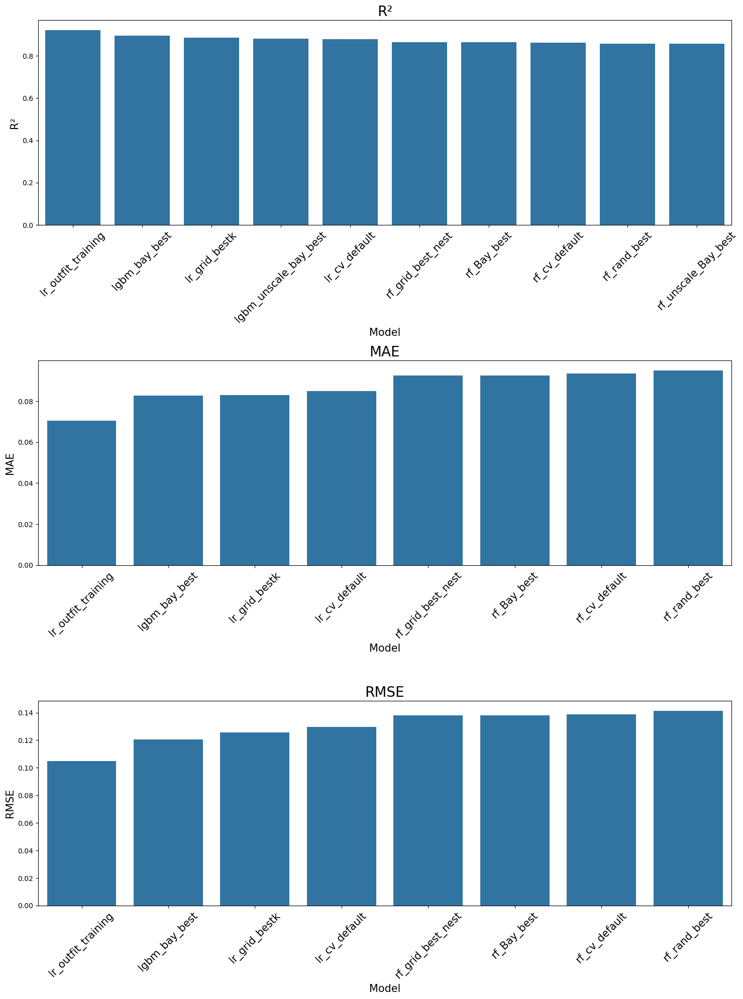

In [209]:
fig, axes = plt.subplots(3, 1, figsize=(15, 20))
sns.barplot(x=model_compare_df['Model'], y=model_compare_df['R²'], ax=axes[0])
axes[0].set_xticklabels(axes[0].get_xticklabels(), rotation=45, fontsize=15)
axes[0].set_xlabel('Model',fontsize=15)
axes[0].set_ylabel('R²',fontsize=15)
axes[0].set_title('R²', fontsize=20)
sns.barplot(x=model_compare_df[model_compare_df['MAE'] < 1]['Model'], y=model_compare_df[model_compare_df['MAE'] < 1]['MAE'], ax=axes[1])
axes[1].set_xticklabels(axes[1].get_xticklabels(), rotation=45, fontsize=15)
axes[1].set_xlabel('Model',fontsize=15)
axes[1].set_ylabel('MAE', fontsize=15)
axes[1].set_title('MAE', fontsize=20)
sns.barplot(x=model_compare_df[model_compare_df['RMSE'] < 1]['Model'], y=model_compare_df[model_compare_df['RMSE'] < 1]['RMSE'], ax=axes[2])
axes[2].set_xticklabels(axes[2].get_xticklabels(), rotation=45, fontsize=15)
axes[2].set_xlabel('Model',fontsize=15)
axes[2].set_ylabel('RMSE', fontsize=15)
axes[2].set_title('RMSE', fontsize=20)

plt.tight_layout()
plt.show()

The top three models based on R² are **lgbm_bay_best** (a LightGBM model with the optimal hyperparameters identified via Bayesian Optimization), **lr_grid_bestk** (a Linear Regression model using the best k features selected through GridSearchCV), and **lgbm_unscale_bay_best** (a LightGBM model optimized via Bayesian Optimization but trained on the unscaled dataset). Notably, these models also achieve some of the lowest MAE and RMSE values, further reinforcing their strong predictive performance. 

In [210]:
pip install dill

Note: you may need to restart the kernel to use updated packages.


In [211]:
import dill

with open("session.pkl", "wb") as f:
    dill.dump_session(f)